In [1]:
%load_ext autoreload
%autoreload 2

In [ ]:
import sys
import os
from os.path import join
import json
import pickle as pkl
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
from tqdm.auto import trange, tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from easydict import EasyDict as edict
sys.path.append("/n/home12/binxuwang/Github/DiffusionLearningCurve")
sys.path.append("/Users/binxuwang/Github/DiffusionLearningCurve/")
from core.diffusion_nn_lib import UNetBlockStyleMLP_backbone
from core.toy_shape_dataset_lib import generate_random_star_shape_torch
from core.diffusion_basics_lib import *
from core.diffusion_edm_lib import *
from core.network_edm_lib import SongUNet, DhariwalUNet
from core.DiT_model_lib import *
from core.diffusion_nn_lib import UNetBlockStyleMLP_backbone
from core.trajectory_convergence_lib import analyze_and_plot_variance, fit_regression_log_scale
from circuit_toolkit.plot_utils import saveallforms, to_imgrid, show_imgrid
from pprint import pprint
from core.trajectory_convergence_lib import analyze_and_plot_variance, fit_regression_log_scale
from core.img_patch_stats_analysis_lib import compute_crossing_points, sweep_and_create_sample_store, process_img_mean_cov_statistics,\
     process_patch_mean_cov_statistics, plot_variance_trajectories, plot_mean_deviation_trajectories, \
     harmonic_mean, smooth_and_find_threshold_crossing
from core.trajectory_convergence_lib import analyze_and_plot_variance
from core.trajectory_convergence_lib import smooth_and_find_threshold_crossing, compute_crossing_points
from core.img_patch_stats_analysis_lib import plot_variance_trajectories

saveroot = f"/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiffusionSpectralLearningCurve"

In [3]:
def find_all_ckpt_steps(ckptdir, verbose=True):
    ckpt_files = [f for f in os.listdir(ckptdir) if f.startswith("model_epoch_") and f.endswith(".pth")]
    ckpt_steps = [int(f.split("_")[-1].split(".")[0]) for f in ckpt_files]
    if verbose:
        print(f"Found {len(ckpt_steps)} checkpoints in the directory, largest step is {max(ckpt_steps)}")
    return sorted(ckpt_steps)


def create_unet_model(config):
    unet = SongUNet(in_channels=config.channels, 
                out_channels=config.channels, 
                num_blocks=config.layers_per_block, 
                attn_resolutions=config.attn_resolutions, 
                decoder_init_attn=config.decoder_init_attn if 'decoder_init_attn' in config else True,
                model_channels=config.model_channels, 
                channel_mult=config.channel_mult, 
                dropout=config.dropout, 
                img_resolution=config.img_size, 
                label_dim=config.label_dim,
                embedding_type='positional', 
                encoder_type='standard', 
                decoder_type='standard', 
                augment_dim=config.augment_dim, #  no augmentation , 9 for defaults. 
                channel_mult_noise=1, 
                resample_filter=[1,1], 
                )
    pytorch_total_grad_params = sum(p.numel() for p in unet.parameters() if p.requires_grad)
    print(f'total number of trainable parameters in the Score Model: {pytorch_total_grad_params}')
    pytorch_total_params = sum(p.numel() for p in unet.parameters())
    print(f'total number of parameters in the Score Model: {pytorch_total_params}')
    return unet

device = "cuda" if torch.cuda.is_available() else "cpu"

In [4]:
def fetch_ref_img_tsr(dataset, ref_img_idx=188):
    """
    Fetch a reference image from the dataset and convert it to a tensor. 
    and normalize to [-1, 1]
    """
    if isinstance(ref_img_idx, int):
        ref_x_raw = dataset[ref_img_idx][0] # 77 is a nice example
    # if it's a iterable, then it's a list of images
    elif isinstance(ref_img_idx, (list, tuple, range, np.ndarray)):
        ref_x_raw = ([dataset[i][0] for i in ref_img_idx])
        ref_x_raw = np.stack(ref_x_raw)
    else:
        raise ValueError(f"Invalid reference image index: {ref_img_idx}")
    ref_x_raw = torch.from_numpy(ref_x_raw).float() / 255.0
    ref_x = (ref_x_raw - 0.5) / 0.5
    return ref_x


In [5]:
from einops import rearrange
def patch_mean_cov(X, P, device='cuda'):
    # X = data_Xtsr[1000:3000].cpu()
    # X = (X - 0.5) / 0.5
    # Y = data_Xtsr[1000:3000].cpu()
    C_out = X.shape[1]
    C_in = X.shape[1]
    # X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
    unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
    X_patches = unfold(X)
    print(X_patches.shape)
    # n_samples, n_patch_elements, n_positions = X_patches.shape
    X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
    patch_mean = X_patches_flatten.mean(dim=0)
    patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
    return patch_mean, patch_cov


def patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device='cuda', verbose=True):
    sigma = noise_level
    eye_mat = torch.eye(patch_cov.shape[0], device=device)
    patch_cov = patch_cov.to(device)
    patch_mean = patch_mean.to(device)
    denoiser_jacobian = patch_cov @ torch.linalg.inv(patch_cov + eye_mat * sigma ** 2)
    denoiser_bias = (eye_mat - denoiser_jacobian) @ patch_mean
    W_center = denoiser_jacobian.view(C_in, P, P, C_in, P, P)[:, P//2, P//2, :, :, :]
    b_center = denoiser_bias.view(C_in, P, P)[:, P//2, P//2]
    if verbose:
        print(W_center.shape)
        print(b_center.shape)
    return denoiser_jacobian, denoiser_bias, W_center, b_center


def compute_patch_Gaussian_denoiser(data_Xtsr, P, noise_level, device='cuda'):
    C_in = data_Xtsr.shape[1]
    print("Computing patch mean and covariance")
    patch_mean, patch_cov = patch_mean_cov(data_Xtsr, P, device="cpu")
    print("Computing patch Gaussian denoiser")
    denoiser_jacobian, denoiser_bias, W_center, b_center = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device)
    return denoiser_jacobian, denoiser_bias, W_center, b_center


def build_linear_conv_denoiser_layer(patch_mean, patch_cov, noise_level, P, C_in, device='cuda'):
    print("Computing patch Gaussian denoiser")
    denoiser_jacobian, denoiser_bias, W_center, b_center = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device)
    conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
    conv_GaussianPatch.weight.data = W_center
    conv_GaussianPatch.bias.data = b_center
    return conv_GaussianPatch


def get_t_steps(sigma_min, sigma_max, num_steps, rho):
    step_indices = torch.arange(num_steps, dtype=torch.float32, device=device)
    t_steps = (sigma_max ** (1 / rho) + step_indices / (num_steps - 1) * (sigma_min ** (1 / rho) - sigma_max ** (1 / rho))) ** rho
    return t_steps

In [6]:
@torch.no_grad()
def edm_sampler_with_linconv(
    linconv_denoiser_dict, latents, 
    num_steps=18, sigma_min=0.002, sigma_max=80, rho=7,
    dtype=torch.float32, return_traj=False,
):
    """
    EDM sampler that uses a dictionary of linear convolutional denoisers for different noise levels.
    
    Args:
        linconv_denoiser_dict (dict): Dictionary mapping noise levels to convolutional denoisers
        latents (torch.Tensor): Initial noise tensor
        num_steps (int): Number of sampling steps
        sigma_min (float): Minimum noise level
        sigma_max (float): Maximum noise level
        rho (float): Noise schedule parameter
        dtype (torch.dtype): Data type for computation
        return_traj (bool): Whether to return the full trajectory
        
    Returns:
        Final sample or (final sample, trajectory, denoiser outputs, time steps)
    """
    device = latents.device
    
    # Time step discretization
    step_indices = torch.arange(num_steps, dtype=dtype, device=device)
    t_steps = (sigma_max ** (1 / rho) + step_indices / (num_steps - 1) * (sigma_min ** (1 / rho) - sigma_max ** (1 / rho))) ** rho
    t_steps = torch.cat([t_steps, torch.zeros_like(t_steps[:1])])  # t_N = 0
    
    x_traj = []
    denoiser_traj = []
    
    # Main sampling loop
    x_next = latents.to(dtype) * t_steps[0]
    x_traj.append(x_next)
    
    for i, (t_cur, t_next) in enumerate(zip(t_steps[:-1], t_steps[1:])):  # 0, ..., N-1
        x_hat = x_next
        t_hat = t_cur
        
        # Find closest noise level in the dictionary
        closest_noise_level = min(linconv_denoiser_dict.keys(), key=lambda k: abs(k - t_hat.item()))
        denoiser = linconv_denoiser_dict[closest_noise_level]
        
        # Euler step
        denoised = denoiser(x_hat)
        d_cur = (x_hat - denoised) / t_hat
        x_next = x_hat + (t_next - t_hat) * d_cur

        # Apply 2nd order correction
        if i < num_steps - 1:
            closest_noise_level = min(linconv_denoiser_dict.keys(), key=lambda k: abs(k - t_next.item()))
            denoiser = linconv_denoiser_dict[closest_noise_level]
            denoised = denoiser(x_next)
            d_prime = (x_next - denoised) / t_next
            x_next = x_hat + (t_next - t_hat) * (0.5 * d_cur + 0.5 * d_prime)
            
        x_traj.append(x_next)
        denoiser_traj.append(denoised)
        
    if return_traj:
        x_traj = torch.stack(x_traj, dim=0)
        denoiser_traj = torch.stack(denoiser_traj, dim=0)
        return x_next, x_traj, denoiser_traj, t_steps
    else:
        return x_next

### FFHQ32 dataset

In [7]:
import sys
from os.path import join
sys.path.append("/n/home12/binxuwang/Github/edm")
from training.dataset import TensorDataset, ImageFolderDataset
sys.path.append("/n/home12/binxuwang/Github/DiffusionLearningCurve")
from core.dataset_lib import load_dataset
edm_dataset_root = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Datasets/EDM_datasets/datasets"
import torch
Xtsr_raw, imgsize = load_dataset("ffhq-32x32", normalize=True)

/n/home12/binxuwang/Github/DiffusionLearningCurve/core/dataset_lib.py:47: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  Xtsr_raw = torch.load(join(word_dataset_root, "ffhq-3

ffhq-32x32 dataset: torch.Size([70000, 3, 32, 32])
Raw value range 1.0 0.0
Normalizing dataset to [-1.0, 1.0]


In [8]:
X_mean = Xtsr_raw.mean(dim=0)
X_cov = torch.cov(Xtsr_raw.flatten(start_dim=1).cuda().T)
eig_vals, eig_vecs = torch.linalg.eigh(X_cov)

In [9]:
Xtsr32_5000 = Xtsr_raw[:5000] # this is after preprocessing
P = 19
# noise_level = 5.0
device = "cpu"
X = Xtsr32_5000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
# denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
# train_patche_bank = X_patches_flatten.to(torch.float16).cuda()

torch.Size([5000, 1083, 1024])


In [10]:
torch.cuda.empty_cache()

In [27]:
t_steps = get_t_steps(0.002, 80, 35, 7)
device = "cuda"
linconv_denoiser_dict = {}
for noise_level in t_steps:
    denoiser_jacobian, denoiser_bias, W_center, b_center = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device)
    # denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
    # build conv model
    conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
    conv_GaussianPatch.weight.data = W_center.to(device)
    conv_GaussianPatch.bias.data = b_center.to(device)
    linconv_denoiser_dict[noise_level.item()] = conv_GaussianPatch.to(device)

torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size([3, 3, 13, 13])
torch.Size([3])
torch.Size(

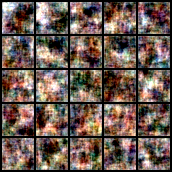

In [28]:
samples = edm_sampler_with_linconv(linconv_denoiser_dict, torch.randn(25, 3, 32, 32).cuda(), 
                         num_steps=35, sigma_min=0.002, sigma_max=80, rho=7)
to_imgrid(((samples + 1) * 0.5).clamp(0, 1), nrow=5)

patch size = 13, tau_eta: 0.01


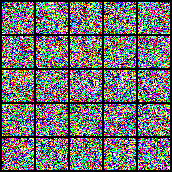

patch size = 13, tau_eta: 0.05


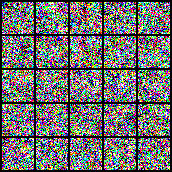

patch size = 13, tau_eta: 0.1


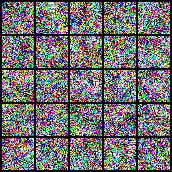

patch size = 13, tau_eta: 0.25


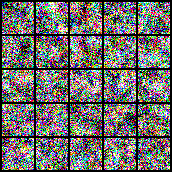

patch size = 13, tau_eta: 0.5


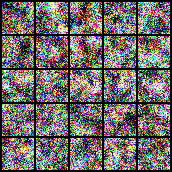

patch size = 13, tau_eta: 1.0


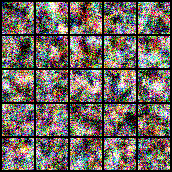

patch size = 13, tau_eta: 2.0


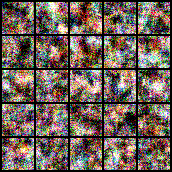

patch size = 13, tau_eta: 5.0


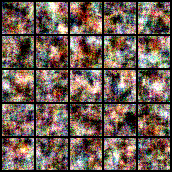

patch size = 13, tau_eta: 10.0


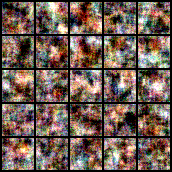

patch size = 13, tau_eta: 20.0


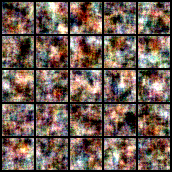

patch size = 13, tau_eta: 50.0


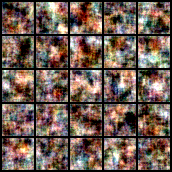

patch size = 13, tau_eta: 100.0


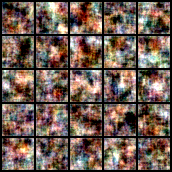

patch size = 13, tau_eta: 200.0


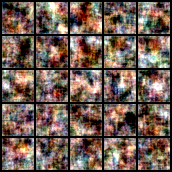

patch size = 13, tau_eta: 500.0


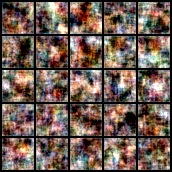

patch size = 13, tau_eta: 1000.0


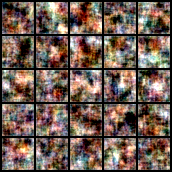

In [39]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
# learning rate * time
tau_eta = 0.25
samples_store = {}
for tau_eta in [0.01, 0.05, 0.1, 0.25, 0.5, 1.0, 2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0, 500.0, 1000.0]:
    linconv_denoiser_learned_dict = {}
    for noise_level in t_steps:
        denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device, verbose=False)
        # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
        shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
        W_residual = (W_center_init - W_center_optimal)
        residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
        residual_learning = residual_learning.view(C_in, C_in, P, P)
        W_center_learned = W_center_optimal + residual_learning
        # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
        b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
        # build conv model
        conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
        conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
        conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
        linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)
    latents = torch.randn(2048, 3, 32, 32, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, latents, 
                            num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    print(f"patch size = {P}, tau_eta: {tau_eta}")
    display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1)[:25], nrow=5))
    samples_store[tau_eta] = samples

### Variance along eigenmodes

In [31]:
samples_eigproj = samples.flatten(start_dim=1) @ eig_vecs
samples_eigvar = torch.var(samples_eigproj, dim=0)

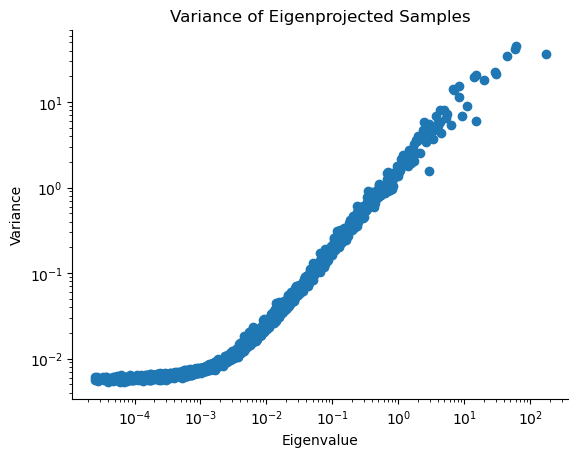

In [36]:
plt.scatter(eig_vals.cpu().numpy(), samples_eigvar.cpu().numpy())
plt.xscale("log")
plt.yscale("log")
plt.xlabel("Eigenvalue")
plt.ylabel("Variance")
plt.title("Variance of Eigenprojected Samples")
plt.show()

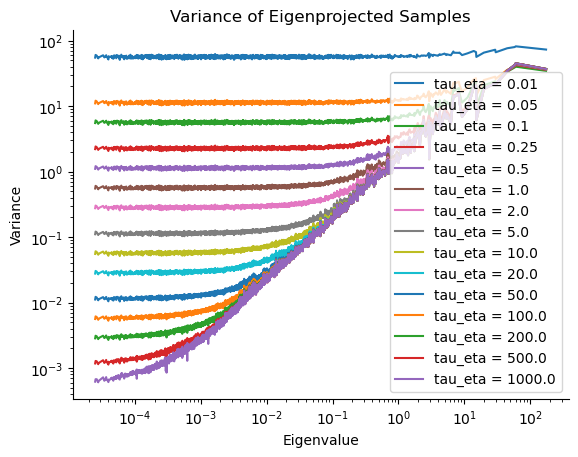

In [41]:
samples_eigvar_store = []
for tau_eta in samples_store.keys():
    samples = samples_store[tau_eta]
    samples_eigproj = samples.flatten(start_dim=1) @ eig_vecs
    samples_eigvar = torch.var(samples_eigproj, dim=0)
    samples_eigvar_store.append(samples_eigvar)
    plt.plot(eig_vals.cpu().numpy(), samples_eigvar.cpu().numpy(), label=f"tau_eta = {tau_eta}")
plt.xscale("log")
plt.yscale("log")
plt.xlabel("Eigenvalue")
plt.ylabel("Variance")
plt.title("Variance of Eigenprojected Samples")
plt.legend()
plt.show()

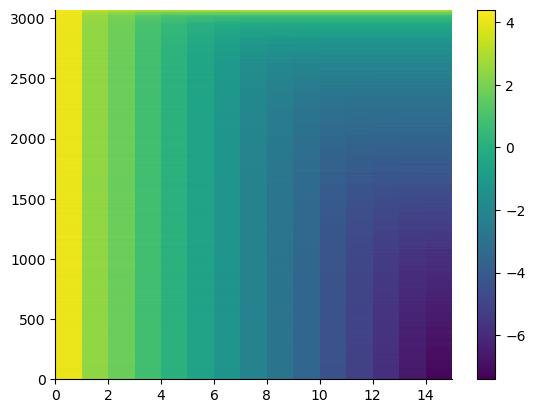

In [44]:
# samples_eigvar_store = torch.stack(samples_eigvar_store)
plt.pcolormesh(samples_eigvar_store.log().T.cpu().numpy())
plt.colorbar()
plt.show()

### Smaller fields

In [ ]:
Xtsr32_5000 = Xtsr_raw[:5000] # this is after preprocessing
P = 5
# noise_level = 5.0
device = "cpu"
X = Xtsr32_5000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
# denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
train_patche_bank = X_patches_flatten.to(torch.float16).cuda()

torch.Size([5000, 75, 1024])


patch size = 5, tau_eta: 0.01


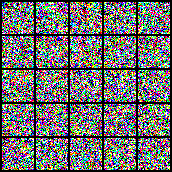

patch size = 5, tau_eta: 0.05


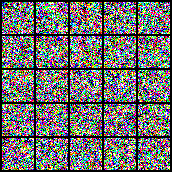

patch size = 5, tau_eta: 0.1


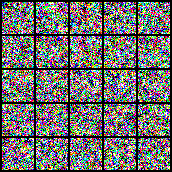

patch size = 5, tau_eta: 0.25


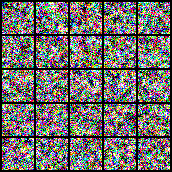

patch size = 5, tau_eta: 0.5


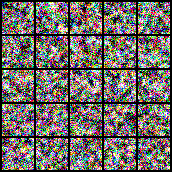

patch size = 5, tau_eta: 1.0


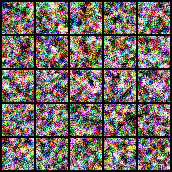

patch size = 5, tau_eta: 2.0


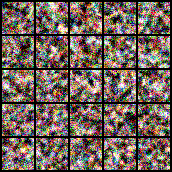

patch size = 5, tau_eta: 5.0


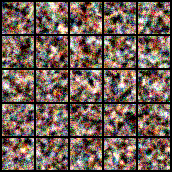

patch size = 5, tau_eta: 10.0


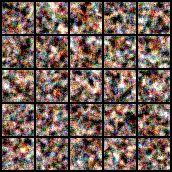

patch size = 5, tau_eta: 20.0


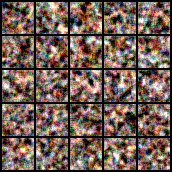

patch size = 5, tau_eta: 50.0


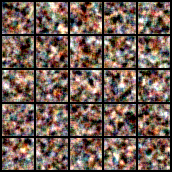

patch size = 5, tau_eta: 100.0


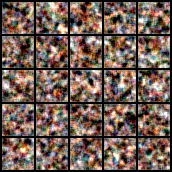

patch size = 5, tau_eta: 200.0


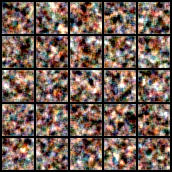

patch size = 5, tau_eta: 500.0


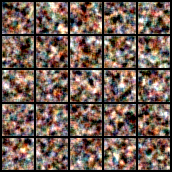

patch size = 5, tau_eta: 1000.0


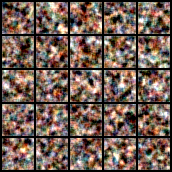

In [46]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
# learning rate * time
tau_eta = 0.25
samples_store = {}
for tau_eta in [0.01, 0.05, 0.1, 0.25, 0.5, 1.0, 2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0, 500.0, 1000.0]:
    linconv_denoiser_learned_dict = {}
    for noise_level in t_steps:
        denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device, verbose=False)
        # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
        shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
        W_residual = (W_center_init - W_center_optimal)
        residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
        residual_learning = residual_learning.view(C_in, C_in, P, P)
        W_center_learned = W_center_optimal + residual_learning
        # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
        b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
        # build conv model
        conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
        conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
        conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
        linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)
    latents = torch.randn(2048, 3, 32, 32, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, latents, 
                            num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    print(f"patch size = {P}, tau_eta: {tau_eta}")
    display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1)[:25], nrow=5))
    samples_store[tau_eta] = samples

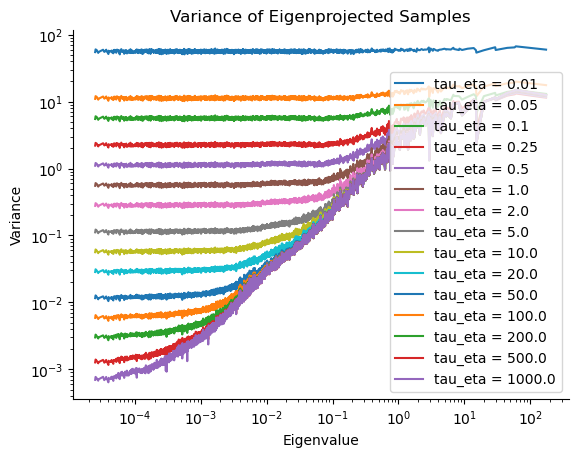

In [ ]:
samples_eigvar_store = []
for tau_eta in samples_store.keys():
    samples = samples_store[tau_eta]
    samples_eigproj = samples.flatten(start_dim=1) @ eig_vecs
    samples_eigvar = torch.var(samples_eigproj, dim=0)
    samples_eigvar_store.append(samples_eigvar)
samples_eigvar_store = torch.stack(samples_eigvar_store)

for tau_eta in samples_store.keys():
    plt.plot(eig_vals.cpu().numpy(), samples_eigvar_store[tau_eta].cpu().numpy(), label=f"tau_eta = {tau_eta}")
plt.xscale("log")
plt.yscale("log")
plt.xlabel("Eigenvalue")
plt.ylabel("Variance")
plt.title("Variance of Eigenprojected Samples")
plt.legend()
plt.show()

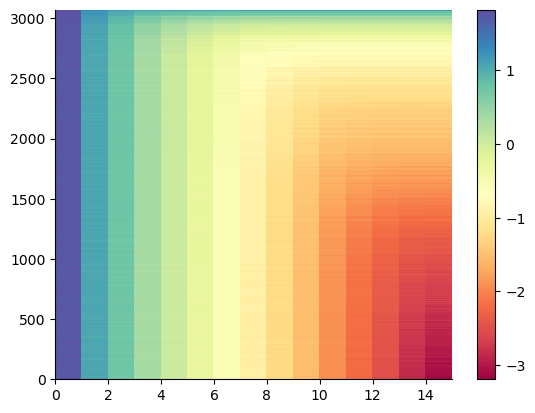

In [ ]:
if isinstance(samples_eigvar_store, list):
    samples_eigvar_store = torch.stack(samples_eigvar_store)
plt.pcolor(samples_eigvar_store.log10().T.cpu().numpy(), cmap="Spectral")
plt.colorbar()
plt.show()

### Training dynamics and variance evolution

In [22]:
from core.trajectory_convergence_lib import analyze_and_plot_variance, fit_regression_log_scale
from core.img_patch_stats_analysis_lib import compute_crossing_points, sweep_and_create_sample_store, process_img_mean_cov_statistics,\
     process_patch_mean_cov_statistics, plot_variance_trajectories, plot_mean_deviation_trajectories, \
     harmonic_mean, smooth_and_find_threshold_crossing
from core.trajectory_convergence_lib import analyze_and_plot_variance
from core.trajectory_convergence_lib import smooth_and_find_threshold_crossing, compute_crossing_points
from core.img_patch_stats_analysis_lib import plot_variance_trajectories

In [ ]:
Xtsr32_5000 = Xtsr_raw[:5000] # this is after preprocessing
P = 19
# noise_level = 5.0
device = "cpu"
X = Xtsr32_5000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
# denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
# train_patche_bank = X_patches_flatten.to(torch.float16).cuda()

In [10]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
# learning rate * time
tau_eta = 0.25
samples_store = {}
for tau_eta in np.logspace(-2, 4, 100):#[0.01, 0.05, 0.1, 0.25, 0.5, 1.0, 2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0, 500.0, 1000.0]:
    linconv_denoiser_learned_dict = {}
    for noise_level in t_steps:
        denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device, verbose=False)
        # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
        shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
        W_residual = (W_center_init - W_center_optimal)
        residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
        residual_learning = residual_learning.view(C_in, C_in, P, P)
        W_center_learned = W_center_optimal + residual_learning
        # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
        b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
        # build conv model
        conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
        conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
        conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
        linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)
    latents = torch.randn(2048, 3, 32, 32, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, latents, 
                            num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    # print(f"patch size = {P}, tau_eta: {tau_eta}")
    # display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1)[:25], nrow=5))
    samples_store[tau_eta] = samples

In [11]:
samples_eigvar_store = []
for tau_eta in samples_store.keys():
    samples = samples_store[tau_eta]
    samples_eigproj = samples.flatten(start_dim=1) @ eig_vecs
    samples_eigvar = torch.var(samples_eigproj, dim=0)
    samples_eigvar_store.append(samples_eigvar)
samples_eigvar_store = torch.stack(samples_eigvar_store)

In [13]:
tau_eta_arr = np.logspace(-2, 4, 100)

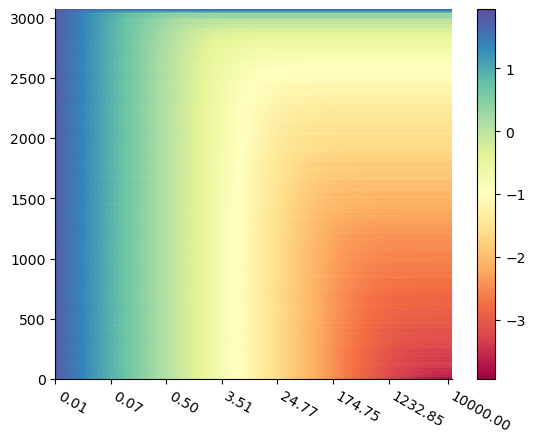

In [16]:
if isinstance(samples_eigvar_store, list):
    samples_eigvar_store = torch.stack(samples_eigvar_store)
plt.pcolor(samples_eigvar_store.log10().T.cpu().numpy(), cmap="Spectral")
tick_indices = np.linspace(0, len(tau_eta_arr)-1, 8, dtype=int)
plt.xticks(tick_indices, ["%.2f"%tau_eta_arr[i] for i in tick_indices], rotation=-30, ha="left")
plt.colorbar()
plt.show()

In [18]:
eig_vals

tensor([2.5128e-05, 2.5508e-05, 2.6531e-05,  ..., 5.8021e+01, 6.0114e+01,
        1.7339e+02], device='cuda:0')

No crossing found for mode 3071


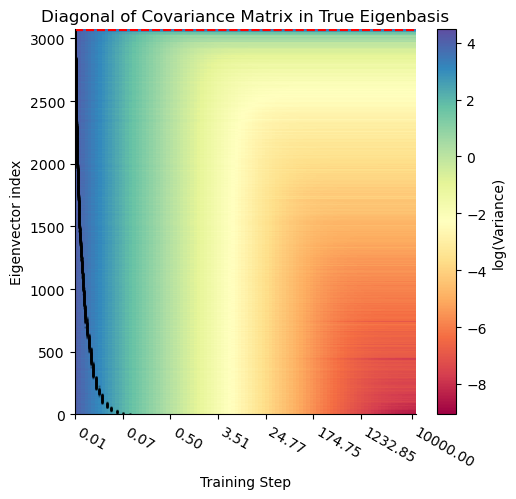

In [21]:
emer_time_df = compute_crossing_points(eig_vals.cpu(), samples_eigvar_store.cpu(), tau_eta_arr, smooth_sigma=1, 
                                       threshold_type="geometric_mean")
# find the eigen index that the initial variance and final variance are similar
var_ratio = samples_eigvar_store[0,:].cpu() / eig_vals.cpu()
eig_idx_tooclose = (var_ratio > 0.5) & (var_ratio < 2)
eig_idx_tooclose_vec = eig_idx_tooclose.nonzero()[:,0]
plt.figure(figsize=(5.5, 5))
plt.pcolor(samples_eigvar_store.log().cpu().numpy().T, cmap="Spectral", rasterized=True)
plt.colorbar(label="log(Variance)")
plt.scatter(emer_time_df["emergence_step"].to_numpy(), emer_time_df.index.to_numpy(), marker=".", c="k", s=3, alpha=0.2, rasterized=True)
plt.axhline(eig_idx_tooclose_vec[0], color="r", linestyle="--")
plt.axhline(eig_idx_tooclose_vec[-1], color="r", linestyle="--")
plt.title("Diagonal of Covariance Matrix in True Eigenbasis")
plt.xlabel("Training Step")
plt.ylabel("Eigenvector index")
# plt.gca().invert_yaxis()  # Flip the y-axis
# annotate x-axis with step_slice
# Only show a subset of ticks to avoid overcrowding
tick_indices = np.linspace(0, len(tau_eta_arr)-1, 8, dtype=int)
plt.xticks(tick_indices, ["%.2f"%tau_eta_arr[i] for i in tick_indices], rotation=-30, ha="left")
# saveallforms(figdir, f"eigenframe_variance_heatmap_{expname}_rasterized", dpi=300)
plt.show()

In [19]:
theory_dir = "/n/home12/binxuwang/Github/DiffusionLearningCurve/figures/theory_linconv_learn_curve"

No crossing found for mode 3071


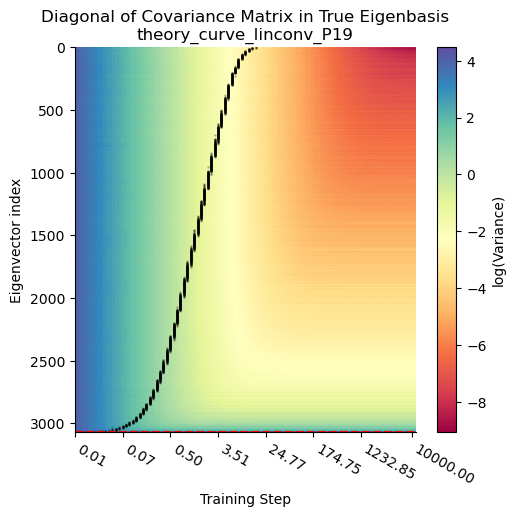

No crossing found for mode 3071
Not enough data points to fit for direction: nan
Direction: increase
Direction: decrease
Slope: -0.49, Intercept: -2.42, R-squared: 1.00 (log-log) [N=3066]
Equation: $y = 0.09 x^{-0.49}$


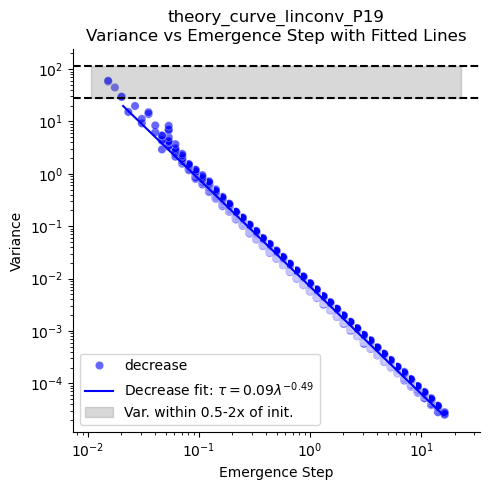

In [26]:
img_eigval = eig_vals.cpu()
diag_cov_x_sample_true_eigenbasis_traj = samples_eigvar_store.cpu()
step_slice = tau_eta_arr
expname = f"theory_curve_linconv_P{P}"
emer_time_df = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), range(len(step_slice)), smooth_sigma=1, threshold_type="geometric_mean")
# find the eigen index that the initial variance and final variance are similar
var_ratio = diag_cov_x_sample_true_eigenbasis_traj[0,:] / img_eigval.cpu()
eig_idx_tooclose = (var_ratio > 0.5) & (var_ratio < 2)
eig_idx_tooclose_vec = eig_idx_tooclose.nonzero()[:,0]
plt.figure(figsize=(5.5, 5))
plt.pcolor(diag_cov_x_sample_true_eigenbasis_traj.log().cpu().numpy().T, cmap="Spectral", rasterized=True)
plt.colorbar(label="log(Variance)")
plt.scatter(emer_time_df["emergence_step"].to_numpy(), emer_time_df.index.to_numpy(), marker=".", c="k", s=3, alpha=0.2, rasterized=True)
plt.axhline(eig_idx_tooclose_vec[0], color="r", linestyle="--")
plt.axhline(eig_idx_tooclose_vec[-1], color="r", linestyle="--")
plt.title(f"Diagonal of Covariance Matrix in True Eigenbasis\n{expname}")
plt.xlabel("Training Step")
plt.ylabel("Eigenvector index")
plt.gca().invert_yaxis()  # Flip the y-axis
# annotate x-axis with step_slice
# Only show a subset of ticks to avoid overcrowding
tick_indices = np.linspace(0, len(step_slice)-1, 8, dtype=int)
plt.xticks(tick_indices, ["%.2f"%step_slice[i] for i in tick_indices], rotation=-30, ha="left")
saveallforms([theory_dir], f"eigenframe_variance_heatmap_{expname}_rasterized", dpi=300)
plt.show()
#%
emer_time_df_step = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), step_slice, smooth_sigma=1, threshold_type="geometric_mean")
# emer_time_df_step.to_csv(join(synopsis_dir, f"emergence_time_df_step_{expname}.csv"))
init_var = diag_cov_x_sample_true_eigenbasis_traj[0,:]
mean_init_var = init_var.mean().item()
exclude_mask = (emer_time_df_step.Variance / mean_init_var > 0.5) & (emer_time_df_step.Variance / mean_init_var < 2)

analyze_and_plot_variance(emer_time_df_step, x_col="emergence_step", y_col="Variance", hue_col="Direction", log_x=True, log_y=True, figsize=(5, 5), 
                        exclude_mask=exclude_mask, reverse_equation=True, fit_label_format='{direction} fit: $\\tau = {a:.2f} \lambda^{{{b:.2f}}}$', 
                        title=f'{expname}\nVariance vs Emergence Step with Fitted Lines', xlabel='Emergence Step', ylabel='Variance', 
                        alpha=0.6, annotate=False, annotate_offset=(0, 0), fit_line_kwargs=None, 
                        scatter_kwargs={"rasterized": True, "linewidth": 0.3}, 
                        ax=None,
                        )
plt.axhline(0.5 * mean_init_var, color="k", linestyle="--")
plt.axhline(2 * mean_init_var, color="k", linestyle="--")
# fill the area between the two lines
XLIM = plt.gca().get_xlim()
plt.fill_betweenx([0.5 * mean_init_var, 2 * mean_init_var], [XLIM[0], XLIM[0]], [XLIM[1], XLIM[1]], 
                color="gray", alpha=0.3, label="Var. within 0.5-2x of init.")
print("Direction: increase",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'increase'")
if len(df_split) > 0:
    fit_dict_increase = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)
    # annotate the R2 of the fit
    plt.text(0.05, 0.8, f"R2: {fit_dict_increase['r_squared']:.2f} (N={fit_dict_increase['N']})", transform=plt.gca().transAxes, ha="left", va="center", color="r")
print("Direction: decrease",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'decrease'")
if len(df_split) > 0:
    fit_dict_decrease = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)

plt.legend()
saveallforms([theory_dir], f"convergence_time_vs_variance_scaling_{expname}_rasterized", dpi=300)
plt.show()

### Smaller kernels P=7

In [27]:
Xtsr32_5000 = Xtsr_raw[:5000] # this is after preprocessing
P = 7
# noise_level = 5.0
device = "cpu"
X = Xtsr32_5000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
# denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
# train_patche_bank = X_patches_flatten.to(torch.float16).cuda()

torch.Size([5000, 147, 1024])


In [28]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
# learning rate * time
tau_eta = 0.25
samples_store = {}
tau_eta_arr = np.logspace(-2, 4, 100)
for tau_eta in tau_eta_arr: #[0.01, 0.05, 0.1, 0.25, 0.5, 1.0, 2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0, 500.0, 1000.0]:
    linconv_denoiser_learned_dict = {}
    for noise_level in t_steps:
        denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device, verbose=False)
        # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
        shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
        W_residual = (W_center_init - W_center_optimal)
        residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
        residual_learning = residual_learning.view(C_in, C_in, P, P)
        W_center_learned = W_center_optimal + residual_learning
        # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
        b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
        # build conv model
        conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
        conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
        conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
        linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)
    latents = torch.randn(2048, 3, 32, 32, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, latents, 
                            num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    # print(f"patch size = {P}, tau_eta: {tau_eta}")
    # display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1)[:25], nrow=5))
    samples_store[tau_eta] = samples

In [29]:
samples_eigvar_store = []
for tau_eta in samples_store.keys():
    samples = samples_store[tau_eta]
    samples_eigproj = samples.flatten(start_dim=1) @ eig_vecs
    samples_eigvar = torch.var(samples_eigproj, dim=0)
    samples_eigvar_store.append(samples_eigvar)
samples_eigvar_store = torch.stack(samples_eigvar_store)

No crossing found for mode 3071


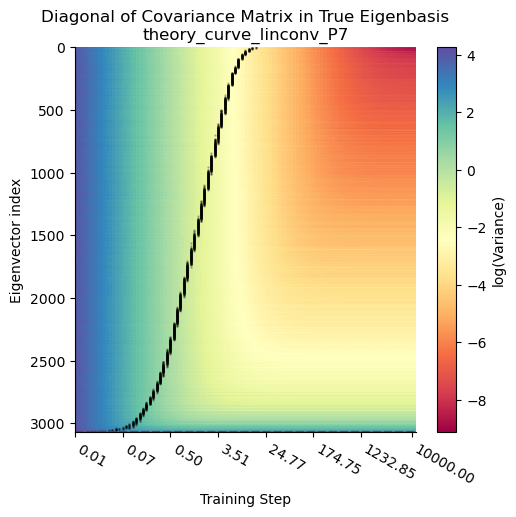

No crossing found for mode 3071
Not enough data points to fit for direction: nan
Direction: increase
Direction: decrease
Slope: -0.48, Intercept: -2.38, R-squared: 1.00 (log-log) [N=3066]
Equation: $y = 0.09 x^{-0.48}$


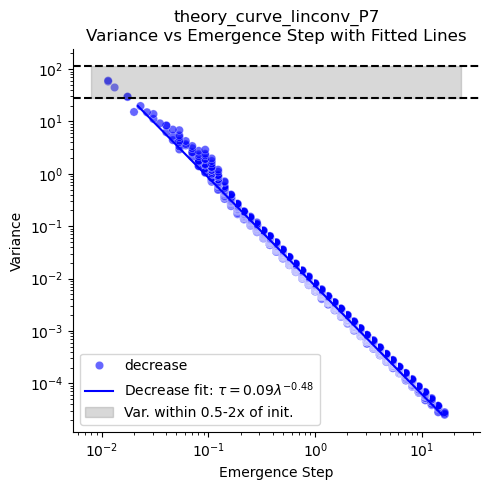

In [30]:
img_eigval = eig_vals.cpu()
diag_cov_x_sample_true_eigenbasis_traj = samples_eigvar_store.cpu()
step_slice = tau_eta_arr
expname = f"theory_curve_linconv_P{P}"
emer_time_df = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), range(len(step_slice)), smooth_sigma=1, threshold_type="geometric_mean")
# find the eigen index that the initial variance and final variance are similar
var_ratio = diag_cov_x_sample_true_eigenbasis_traj[0,:] / img_eigval.cpu()
eig_idx_tooclose = (var_ratio > 0.5) & (var_ratio < 2)
eig_idx_tooclose_vec = eig_idx_tooclose.nonzero()[:,0]
plt.figure(figsize=(5.5, 5))
plt.pcolor(diag_cov_x_sample_true_eigenbasis_traj.log().cpu().numpy().T, cmap="Spectral", rasterized=True)
plt.colorbar(label="log(Variance)")
plt.scatter(emer_time_df["emergence_step"].to_numpy(), emer_time_df.index.to_numpy(), marker=".", c="k", s=3, alpha=0.2, rasterized=True)
plt.axhline(eig_idx_tooclose_vec[0], color="r", linestyle="--")
plt.axhline(eig_idx_tooclose_vec[-1], color="r", linestyle="--")
plt.title(f"Diagonal of Covariance Matrix in True Eigenbasis\n{expname}")
plt.xlabel("Training Step")
plt.ylabel("Eigenvector index")
plt.gca().invert_yaxis()  # Flip the y-axis
# annotate x-axis with step_slice
# Only show a subset of ticks to avoid overcrowding
tick_indices = np.linspace(0, len(step_slice)-1, 8, dtype=int)
plt.xticks(tick_indices, ["%.2f"%step_slice[i] for i in tick_indices], rotation=-30, ha="left")
saveallforms([theory_dir], f"eigenframe_variance_heatmap_{expname}_rasterized", dpi=300)
plt.show()
#%
emer_time_df_step = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), step_slice, smooth_sigma=1, threshold_type="geometric_mean")
# emer_time_df_step.to_csv(join(synopsis_dir, f"emergence_time_df_step_{expname}.csv"))
init_var = diag_cov_x_sample_true_eigenbasis_traj[0,:]
mean_init_var = init_var.mean().item()
exclude_mask = (emer_time_df_step.Variance / mean_init_var > 0.5) & (emer_time_df_step.Variance / mean_init_var < 2)

analyze_and_plot_variance(emer_time_df_step, x_col="emergence_step", y_col="Variance", hue_col="Direction", log_x=True, log_y=True, figsize=(5, 5), 
                        exclude_mask=exclude_mask, reverse_equation=True, fit_label_format='{direction} fit: $\\tau = {a:.2f} \lambda^{{{b:.2f}}}$', 
                        title=f'{expname}\nVariance vs Emergence Step with Fitted Lines', xlabel='Emergence Step', ylabel='Variance', 
                        alpha=0.6, annotate=False, annotate_offset=(0, 0), fit_line_kwargs=None, 
                        scatter_kwargs={"rasterized": True, "linewidth": 0.3}, 
                        ax=None,
                        )
plt.axhline(0.5 * mean_init_var, color="k", linestyle="--")
plt.axhline(2 * mean_init_var, color="k", linestyle="--")
# fill the area between the two lines
XLIM = plt.gca().get_xlim()
plt.fill_betweenx([0.5 * mean_init_var, 2 * mean_init_var], [XLIM[0], XLIM[0]], [XLIM[1], XLIM[1]], 
                color="gray", alpha=0.3, label="Var. within 0.5-2x of init.")
print("Direction: increase",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'increase'")
if len(df_split) > 0:
    fit_dict_increase = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)
    # annotate the R2 of the fit
    plt.text(0.05, 0.8, f"R2: {fit_dict_increase['r_squared']:.2f} (N={fit_dict_increase['N']})", transform=plt.gca().transAxes, ha="left", va="center", color="r")
print("Direction: decrease",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'decrease'")
if len(df_split) > 0:
    fit_dict_decrease = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)

plt.legend()
saveallforms([theory_dir], f"convergence_time_vs_variance_scaling_{expname}_rasterized", dpi=300)
plt.show()

### Smaller kernel P=5

In [31]:
Xtsr32_5000 = Xtsr_raw[:5000] # this is after preprocessing
P = 5
# noise_level = 5.0
device = "cpu"
X = Xtsr32_5000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
# denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
# train_patche_bank = X_patches_flatten.to(torch.float16).cuda()

torch.Size([5000, 75, 1024])


In [32]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
# learning rate * time
tau_eta = 0.25
samples_store = {}
tau_eta_arr = np.logspace(-2, 4, 100)
for tau_eta in tau_eta_arr: #[0.01, 0.05, 0.1, 0.25, 0.5, 1.0, 2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0, 500.0, 1000.0]:
    linconv_denoiser_learned_dict = {}
    for noise_level in t_steps:
        denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device, verbose=False)
        # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
        shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
        W_residual = (W_center_init - W_center_optimal)
        residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
        residual_learning = residual_learning.view(C_in, C_in, P, P)
        W_center_learned = W_center_optimal + residual_learning
        # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
        b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
        # build conv model
        conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
        conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
        conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
        linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)
    latents = torch.randn(2048, 3, 32, 32, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, latents, 
                            num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    # print(f"patch size = {P}, tau_eta: {tau_eta}")
    # display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1)[:25], nrow=5))
    samples_store[tau_eta] = samples

In [33]:
samples_eigvar_store = []
for tau_eta in samples_store.keys():
    samples = samples_store[tau_eta]
    samples_eigproj = samples.flatten(start_dim=1) @ eig_vecs
    samples_eigvar = torch.var(samples_eigproj, dim=0)
    samples_eigvar_store.append(samples_eigvar)
samples_eigvar_store = torch.stack(samples_eigvar_store)

No crossing found for mode 3071


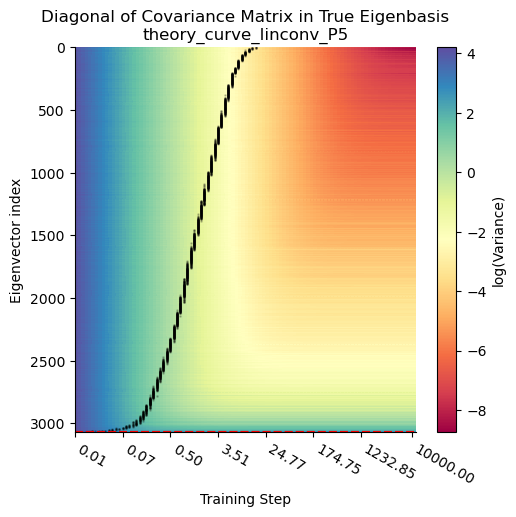

No crossing found for mode 3071
Not enough data points to fit for direction: nan
Direction: increase
Direction: decrease
Slope: -0.48, Intercept: -2.38, R-squared: 1.00 (log-log) [N=3066]
Equation: $y = 0.09 x^{-0.48}$


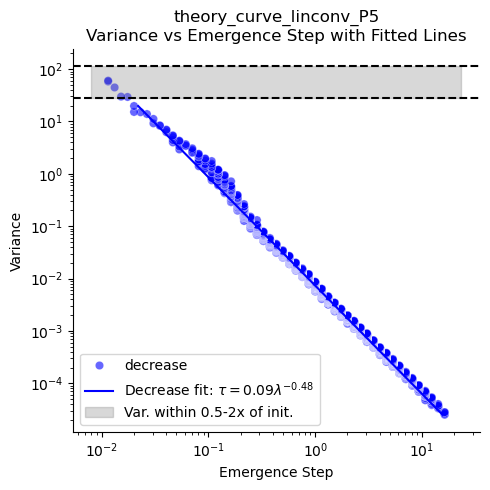

In [ ]:
img_eigval = eig_vals.cpu()
diag_cov_x_sample_true_eigenbasis_traj = samples_eigvar_store.cpu()
step_slice = tau_eta_arr
expname = f"theory_curve_linconv_P{P}"
mtg = to_imgrid(((1 + samples_store[tau_eta_arr[-1]][:25]) * 0.5).clamp(0, 1), nrow=5)
display(mtg)
mtg.save(join(theory_dir, f"{expname}_final_samples.png"))

emer_time_df = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), range(len(step_slice)), smooth_sigma=1, threshold_type="geometric_mean")
# find the eigen index that the initial variance and final variance are similar
var_ratio = diag_cov_x_sample_true_eigenbasis_traj[0,:] / img_eigval.cpu()
eig_idx_tooclose = (var_ratio > 0.5) & (var_ratio < 2)
eig_idx_tooclose_vec = eig_idx_tooclose.nonzero()[:,0]
plt.figure(figsize=(5.5, 5))
plt.pcolor(diag_cov_x_sample_true_eigenbasis_traj.log().cpu().numpy().T, cmap="Spectral", rasterized=True)
plt.colorbar(label="log(Variance)")
plt.scatter(emer_time_df["emergence_step"].to_numpy(), emer_time_df.index.to_numpy(), marker=".", c="k", s=3, alpha=0.2, rasterized=True)
plt.axhline(eig_idx_tooclose_vec[0], color="r", linestyle="--")
plt.axhline(eig_idx_tooclose_vec[-1], color="r", linestyle="--")
plt.title(f"Diagonal of Covariance Matrix in True Eigenbasis\n{expname}")
plt.xlabel("Training Step")
plt.ylabel("Eigenvector index")
plt.gca().invert_yaxis()  # Flip the y-axis
# annotate x-axis with step_slice
# Only show a subset of ticks to avoid overcrowding
tick_indices = np.linspace(0, len(step_slice)-1, 8, dtype=int)
plt.xticks(tick_indices, ["%.2f"%step_slice[i] for i in tick_indices], rotation=-30, ha="left")
saveallforms([theory_dir], f"eigenframe_variance_heatmap_{expname}_rasterized", dpi=300)
plt.show()
#%
emer_time_df_step = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), step_slice, smooth_sigma=1, threshold_type="geometric_mean")
# emer_time_df_step.to_csv(join(synopsis_dir, f"emergence_time_df_step_{expname}.csv"))
init_var = diag_cov_x_sample_true_eigenbasis_traj[0,:]
mean_init_var = init_var.mean().item()
exclude_mask = (emer_time_df_step.Variance / mean_init_var > 0.5) & (emer_time_df_step.Variance / mean_init_var < 2)

analyze_and_plot_variance(emer_time_df_step, x_col="emergence_step", y_col="Variance", hue_col="Direction", log_x=True, log_y=True, figsize=(5, 5), 
                        exclude_mask=exclude_mask, reverse_equation=True, fit_label_format='{direction} fit: $\\tau = {a:.2f} \lambda^{{{b:.2f}}}$', 
                        title=f'{expname}\nVariance vs Emergence Step with Fitted Lines', xlabel='Emergence Step', ylabel='Variance', 
                        alpha=0.6, annotate=False, annotate_offset=(0, 0), fit_line_kwargs=None, 
                        scatter_kwargs={"rasterized": True, "linewidth": 0.3}, 
                        ax=None,
                        )
plt.axhline(0.5 * mean_init_var, color="k", linestyle="--")
plt.axhline(2 * mean_init_var, color="k", linestyle="--")
# fill the area between the two lines
XLIM = plt.gca().get_xlim()
plt.fill_betweenx([0.5 * mean_init_var, 2 * mean_init_var], [XLIM[0], XLIM[0]], [XLIM[1], XLIM[1]], 
                color="gray", alpha=0.3, label="Var. within 0.5-2x of init.")
print("Direction: increase",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'increase'")
if len(df_split) > 0:
    fit_dict_increase = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)
    # annotate the R2 of the fit
    plt.text(0.05, 0.8, f"R2: {fit_dict_increase['r_squared']:.2f} (N={fit_dict_increase['N']})", transform=plt.gca().transAxes, ha="left", va="center", color="r")
print("Direction: decrease",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'decrease'")
if len(df_split) > 0:
    fit_dict_decrease = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)

plt.legend()
saveallforms([theory_dir], f"convergence_time_vs_variance_scaling_{expname}_rasterized", dpi=300)
plt.show()

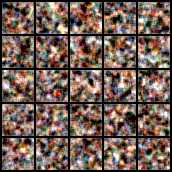

## EDM Preconditioning and learning dynamics

In [14]:
torch.linalg.eigh(patch_cov)

torch.return_types.linalg_eigh(
eigenvalues=tensor([7.3178e-05, 1.1126e-04, 1.1213e-04, 1.6513e-04, 1.7230e-04, 1.7257e-04,
        2.2424e-04, 2.3460e-04, 2.7023e-04, 2.7556e-04, 3.0477e-04, 3.0553e-04,
        3.1992e-04, 3.7851e-04, 3.9361e-04, 4.4130e-04, 4.4222e-04, 4.4904e-04,
        4.6821e-04, 4.9336e-04, 5.3669e-04, 5.6139e-04, 6.2887e-04, 6.4932e-04,
        7.1357e-04, 7.7850e-04, 7.8464e-04, 7.9772e-04, 8.0397e-04, 9.1556e-04,
        9.6963e-04, 9.7820e-04, 9.8078e-04, 1.0663e-03, 1.1022e-03, 1.1802e-03,
        1.2442e-03, 1.3034e-03, 1.3579e-03, 1.3676e-03, 1.4439e-03, 1.4978e-03,
        1.5604e-03, 1.5610e-03, 1.6475e-03, 1.7649e-03, 1.8410e-03, 1.9137e-03,
        2.0047e-03, 2.1137e-03, 2.2132e-03, 2.2907e-03, 2.5427e-03, 2.5594e-03,
        2.5943e-03, 2.7236e-03, 2.8561e-03, 3.1021e-03, 3.1928e-03, 3.2360e-03,
        3.6889e-03, 3.9305e-03, 4.1855e-03, 4.4989e-03, 4.5469e-03, 4.7210e-03,
        4.9476e-03, 4.9703e-03, 5.0898e-03, 5.9350e-03, 6.0566e-03, 6.0990e-

In [28]:
def compute_edm_precond_coeff(sigma_vec, sigma_data=0.5):
    c_skip = sigma_data ** 2 / (sigma_vec ** 2 + sigma_data ** 2)
    c_out = sigma_vec * sigma_data / torch.sqrt(sigma_vec ** 2 + sigma_data ** 2)
    return c_skip, c_out


Let's consider how preconditioning affects the dynamics

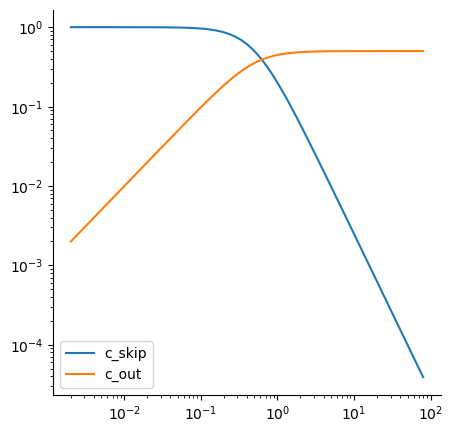

In [34]:

t_steps = get_t_steps(0.002, 80, 70, 7).cpu()
c_skip_arr, c_out_arr = compute_edm_precond_coeff(t_steps, sigma_data=0.5)

plt.figure(figsize=(5, 5))
plt.plot(t_steps, c_skip_arr, label="c_skip")
plt.plot(t_steps, c_out_arr, label="c_out")
plt.xscale("log")
plt.yscale("log")
plt.legend()
plt.show()

In [ ]:
theory_dir = "/n/home12/binxuwang/Github/DiffusionLearningCurve/figures/theory_linconv_learn_curve"

In [ ]:
Xtsr32_5000 = Xtsr_raw[:5000] # this is after preprocessing
P = 7
# noise_level = 5.0
device = "cpu"
X = Xtsr32_5000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
# denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
# train_patche_bank = X_patches_flatten.to(torch.float16).cuda()

torch.Size([5000, 147, 1024])


In [ ]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
identity_W = W_center_init.clone()
# learning rate * time
tau_eta = 0.25
samples_store = {}
tau_eta_arr = np.logspace(-2, 4, 100)
for tau_eta in tau_eta_arr: #[0.01, 0.05, 0.1, 0.25, 0.5, 1.0, 2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0, 500.0, 1000.0]:
    linconv_denoiser_learned_dict = {}
    for noise_level in t_steps:
        c_skip, c_out = compute_edm_precond_coeff(noise_level, sigma_data=0.5)
        denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device, verbose=False)
        # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
        shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
        W_residual = (c_skip * identity_W - W_center_optimal) #+ c_out * W_center_init
        # W_residual = (c_skip * identity_W - W_center_optimal) #+ c_out * W_center_init
        residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
        residual_learning = residual_learning.view(C_in, C_in, P, P)
        W_center_learned = W_center_optimal + residual_learning
        # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
        b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
        # build conv model
        conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
        conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
        conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
        linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)
    latents = torch.randn(2048, 3, 32, 32, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, latents, 
                            num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    # print(f"patch size = {P}, tau_eta: {tau_eta}")
    # display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1)[:25], nrow=5))
    samples_store[tau_eta] = samples

In [25]:
samples_eigvar_store = []
for tau_eta in samples_store.keys():
    samples = samples_store[tau_eta]
    samples_eigproj = samples.flatten(start_dim=1) @ eig_vecs
    samples_eigvar = torch.var(samples_eigproj, dim=0)
    samples_eigvar_store.append(samples_eigvar)
samples_eigvar_store = torch.stack(samples_eigvar_store)

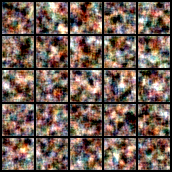

No crossing found for mode 2462
No crossing found for mode 2518
No crossing found for mode 2541
No crossing found for mode 2547
No crossing found for mode 2552
No crossing found for mode 2553
No crossing found for mode 2555
No crossing found for mode 2557
No crossing found for mode 2564
No crossing found for mode 2566
No crossing found for mode 2571
No crossing found for mode 2574
No crossing found for mode 2579
No crossing found for mode 2583
No crossing found for mode 2584
No crossing found for mode 2586
No crossing found for mode 2588
No crossing found for mode 2589
No crossing found for mode 2590
No crossing found for mode 2591
No crossing found for mode 2592
No crossing found for mode 2593
No crossing found for mode 2594
No crossing found for mode 2598
No crossing found for mode 2601
No crossing found for mode 2602
No crossing found for mode 2603
No crossing found for mode 2604
No crossing found for mode 2605
No crossing found for mode 2606
No crossing found for mode 2607
No cross

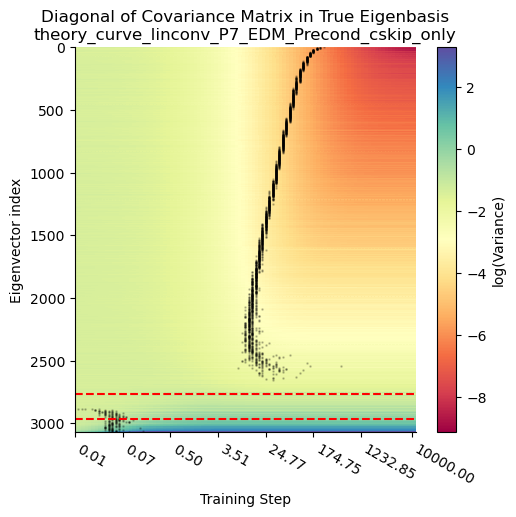

No crossing found for mode 2462
No crossing found for mode 2518
No crossing found for mode 2541
No crossing found for mode 2547
No crossing found for mode 2552
No crossing found for mode 2553
No crossing found for mode 2555
No crossing found for mode 2557
No crossing found for mode 2564
No crossing found for mode 2566
No crossing found for mode 2571
No crossing found for mode 2574
No crossing found for mode 2579
No crossing found for mode 2583
No crossing found for mode 2584
No crossing found for mode 2586
No crossing found for mode 2588
No crossing found for mode 2589
No crossing found for mode 2590
No crossing found for mode 2591
No crossing found for mode 2592
No crossing found for mode 2593
No crossing found for mode 2594
No crossing found for mode 2598
No crossing found for mode 2601
No crossing found for mode 2602
No crossing found for mode 2603
No crossing found for mode 2604
No crossing found for mode 2605
No crossing found for mode 2606
No crossing found for mode 2607
No cross

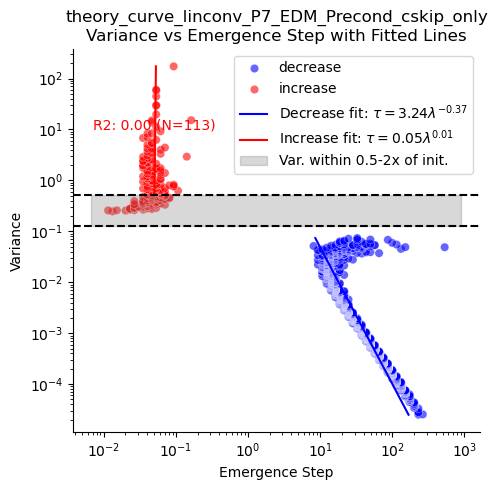

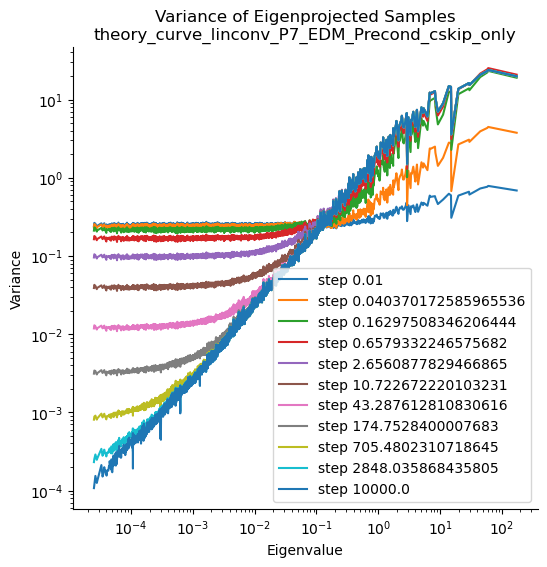

In [35]:
img_eigval = eig_vals.cpu()
diag_cov_x_sample_true_eigenbasis_traj = samples_eigvar_store.cpu()
step_slice = tau_eta_arr
expname = f"theory_curve_linconv_P{P}_EDM_Precond_cskip_only"
mtg = to_imgrid(((1 + samples_store[tau_eta_arr[-1]][:25]) * 0.5).clamp(0, 1), nrow=5)
display(mtg)
mtg.save(join(theory_dir, f"{expname}_final_samples.png"))

emer_time_df = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), range(len(step_slice)), smooth_sigma=1, threshold_type="geometric_mean")
# find the eigen index that the initial variance and final variance are similar
var_ratio = diag_cov_x_sample_true_eigenbasis_traj[0,:] / img_eigval.cpu()
eig_idx_tooclose = (var_ratio > 0.5) & (var_ratio < 2)
eig_idx_tooclose_vec = eig_idx_tooclose.nonzero()[:,0]
plt.figure(figsize=(5.5, 5))
plt.pcolor(diag_cov_x_sample_true_eigenbasis_traj.log().cpu().numpy().T, cmap="Spectral", rasterized=True)
plt.colorbar(label="log(Variance)")
plt.scatter(emer_time_df["emergence_step"].to_numpy(), emer_time_df.index.to_numpy(), marker=".", c="k", s=3, alpha=0.2, rasterized=True)
plt.axhline(eig_idx_tooclose_vec[0], color="r", linestyle="--")
plt.axhline(eig_idx_tooclose_vec[-1], color="r", linestyle="--")
plt.title(f"Diagonal of Covariance Matrix in True Eigenbasis\n{expname}")
plt.xlabel("Training Step")
plt.ylabel("Eigenvector index")
plt.gca().invert_yaxis()  # Flip the y-axis
# annotate x-axis with step_slice
# Only show a subset of ticks to avoid overcrowding
tick_indices = np.linspace(0, len(step_slice)-1, 8, dtype=int)
plt.xticks(tick_indices, ["%.2f"%step_slice[i] for i in tick_indices], rotation=-30, ha="left")
saveallforms([theory_dir], f"eigenframe_variance_heatmap_{expname}_rasterized", dpi=300)
plt.show()
#%
emer_time_df_step = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), step_slice, smooth_sigma=1, threshold_type="geometric_mean")
# emer_time_df_step.to_csv(join(synopsis_dir, f"emergence_time_df_step_{expname}.csv"))
init_var = diag_cov_x_sample_true_eigenbasis_traj[0,:]
mean_init_var = init_var.mean().item()
exclude_mask = (emer_time_df_step.Variance / mean_init_var > 0.5) & (emer_time_df_step.Variance / mean_init_var < 2)

analyze_and_plot_variance(emer_time_df_step, x_col="emergence_step", y_col="Variance", hue_col="Direction", log_x=True, log_y=True, figsize=(5, 5), 
                        exclude_mask=exclude_mask, reverse_equation=True, fit_label_format='{direction} fit: $\\tau = {a:.2f} \lambda^{{{b:.2f}}}$', 
                        title=f'{expname}\nVariance vs Emergence Step with Fitted Lines', xlabel='Emergence Step', ylabel='Variance', 
                        alpha=0.6, annotate=False, annotate_offset=(0, 0), fit_line_kwargs=None, 
                        scatter_kwargs={"rasterized": True, "linewidth": 0.3}, 
                        ax=None,
                        )
plt.axhline(0.5 * mean_init_var, color="k", linestyle="--")
plt.axhline(2 * mean_init_var, color="k", linestyle="--")
# fill the area between the two lines
XLIM = plt.gca().get_xlim()
plt.fill_betweenx([0.5 * mean_init_var, 2 * mean_init_var], [XLIM[0], XLIM[0]], [XLIM[1], XLIM[1]], 
                color="gray", alpha=0.3, label="Var. within 0.5-2x of init.")
print("Direction: increase",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'increase'")
if len(df_split) > 0:
    fit_dict_increase = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)
    # annotate the R2 of the fit
    plt.text(0.05, 0.8, f"R2: {fit_dict_increase['r_squared']:.2f} (N={fit_dict_increase['N']})", transform=plt.gca().transAxes, ha="left", va="center", color="r")
print("Direction: decrease",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'decrease'")
if len(df_split) > 0:
    fit_dict_decrease = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)

plt.legend()
saveallforms([theory_dir], f"convergence_time_vs_variance_scaling_{expname}_rasterized", dpi=300)
plt.show()

plt.figure(figsize=(6, 6))
for step_id in [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, len(step_slice)-1]:
    if step_id < len(step_slice):
        plt.plot(img_eigval.cpu().numpy(), 
                diag_cov_x_sample_true_eigenbasis_traj.cpu().numpy()[step_id,:], 
                label=f"step {step_slice[step_id]}")
plt.xscale("log")
plt.yscale("log")
plt.xlabel("Eigenvalue")
plt.ylabel("Variance")
plt.title(f"Variance of Eigenprojected Samples\n{expname}")
plt.legend()
saveallforms([theory_dir], f"generated_spectral_evolution_{expname}", dpi=300)
plt.show()

### Larger RF

In [36]:
Xtsr32_5000 = Xtsr_raw[:5000] # this is after preprocessing
P = 15
# noise_level = 5.0
device = "cpu"
X = Xtsr32_5000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
# denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
# train_patche_bank = X_patches_flatten.to(torch.float16).cuda()

torch.Size([5000, 675, 1024])


In [37]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
identity_W = W_center_init.clone()
# learning rate * time
tau_eta = 0.25
samples_store = {}
tau_eta_arr = np.logspace(-2, 4, 100)
for tau_eta in tau_eta_arr: #[0.01, 0.05, 0.1, 0.25, 0.5, 1.0, 2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0, 500.0, 1000.0]:
    linconv_denoiser_learned_dict = {}
    for noise_level in t_steps:
        c_skip, c_out = compute_edm_precond_coeff(noise_level, sigma_data=0.5)
        denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device, verbose=False)
        # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
        shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
        W_residual = (c_skip * identity_W - W_center_optimal) #+ c_out * W_center_init
        # W_residual = (c_skip * identity_W - W_center_optimal) #+ c_out * W_center_init
        residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
        residual_learning = residual_learning.view(C_in, C_in, P, P)
        W_center_learned = W_center_optimal + residual_learning
        # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
        b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
        # build conv model
        conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
        conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
        conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
        linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)
    latents = torch.randn(2048, 3, 32, 32, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, latents, 
                            num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    # print(f"patch size = {P}, tau_eta: {tau_eta}")
    # display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1)[:25], nrow=5))
    samples_store[tau_eta] = samples

In [38]:
samples_eigvar_store = []
for tau_eta in samples_store.keys():
    samples = samples_store[tau_eta]
    samples_eigproj = samples.flatten(start_dim=1) @ eig_vecs
    samples_eigvar = torch.var(samples_eigproj, dim=0)
    samples_eigvar_store.append(samples_eigvar)
samples_eigvar_store = torch.stack(samples_eigvar_store)

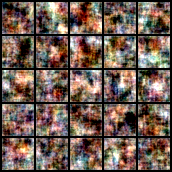

No crossing found for mode 2518
No crossing found for mode 2552
No crossing found for mode 2557
No crossing found for mode 2588
No crossing found for mode 2593
No crossing found for mode 2598
No crossing found for mode 2605
No crossing found for mode 2606
No crossing found for mode 2609
No crossing found for mode 2613
No crossing found for mode 2614
No crossing found for mode 2617
No crossing found for mode 2618
No crossing found for mode 2620
No crossing found for mode 2625
No crossing found for mode 2626
No crossing found for mode 2627
No crossing found for mode 2628
No crossing found for mode 2629
No crossing found for mode 2631
No crossing found for mode 2632
No crossing found for mode 2637
No crossing found for mode 2641
No crossing found for mode 2644
No crossing found for mode 2645
No crossing found for mode 2648
No crossing found for mode 2649
No crossing found for mode 2650
No crossing found for mode 2654
No crossing found for mode 2661
No crossing found for mode 2665
No cross

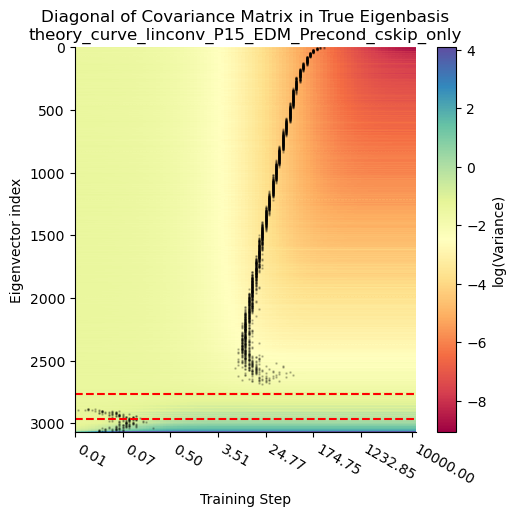

No crossing found for mode 2518
No crossing found for mode 2552
No crossing found for mode 2557
No crossing found for mode 2588
No crossing found for mode 2593
No crossing found for mode 2598
No crossing found for mode 2605
No crossing found for mode 2606
No crossing found for mode 2609
No crossing found for mode 2613
No crossing found for mode 2614
No crossing found for mode 2617
No crossing found for mode 2618
No crossing found for mode 2620
No crossing found for mode 2625
No crossing found for mode 2626
No crossing found for mode 2627
No crossing found for mode 2628
No crossing found for mode 2629
No crossing found for mode 2631
No crossing found for mode 2632
No crossing found for mode 2637
No crossing found for mode 2641
No crossing found for mode 2644
No crossing found for mode 2645
No crossing found for mode 2648
No crossing found for mode 2649
No crossing found for mode 2650
No crossing found for mode 2654
No crossing found for mode 2661
No crossing found for mode 2665
No cross

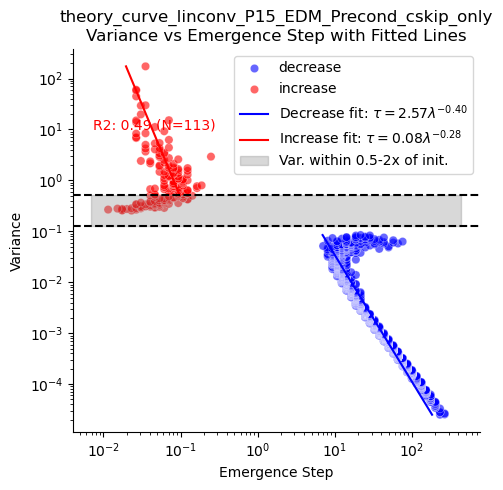

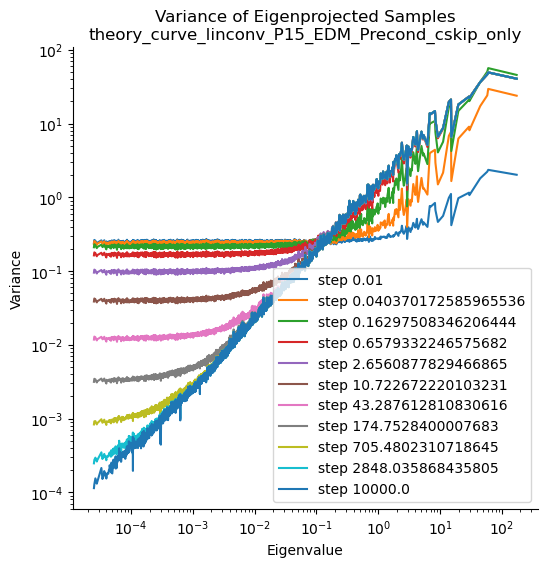

In [39]:
img_eigval = eig_vals.cpu()
diag_cov_x_sample_true_eigenbasis_traj = samples_eigvar_store.cpu()
step_slice = tau_eta_arr
expname = f"theory_curve_linconv_P{P}_EDM_Precond_cskip_only"
mtg = to_imgrid(((1 + samples_store[tau_eta_arr[-1]][:25]) * 0.5).clamp(0, 1), nrow=5)
display(mtg)
mtg.save(join(theory_dir, f"{expname}_final_samples.png"))

emer_time_df = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), range(len(step_slice)), smooth_sigma=1, threshold_type="geometric_mean")
# find the eigen index that the initial variance and final variance are similar
var_ratio = diag_cov_x_sample_true_eigenbasis_traj[0,:] / img_eigval.cpu()
eig_idx_tooclose = (var_ratio > 0.5) & (var_ratio < 2)
eig_idx_tooclose_vec = eig_idx_tooclose.nonzero()[:,0]
plt.figure(figsize=(5.5, 5))
plt.pcolor(diag_cov_x_sample_true_eigenbasis_traj.log().cpu().numpy().T, cmap="Spectral", rasterized=True)
plt.colorbar(label="log(Variance)")
plt.scatter(emer_time_df["emergence_step"].to_numpy(), emer_time_df.index.to_numpy(), marker=".", c="k", s=3, alpha=0.2, rasterized=True)
plt.axhline(eig_idx_tooclose_vec[0], color="r", linestyle="--")
plt.axhline(eig_idx_tooclose_vec[-1], color="r", linestyle="--")
plt.title(f"Diagonal of Covariance Matrix in True Eigenbasis\n{expname}")
plt.xlabel("Training Step")
plt.ylabel("Eigenvector index")
plt.gca().invert_yaxis()  # Flip the y-axis
# annotate x-axis with step_slice
# Only show a subset of ticks to avoid overcrowding
tick_indices = np.linspace(0, len(step_slice)-1, 8, dtype=int)
plt.xticks(tick_indices, ["%.2f"%step_slice[i] for i in tick_indices], rotation=-30, ha="left")
saveallforms([theory_dir], f"eigenframe_variance_heatmap_{expname}_rasterized", dpi=300)
plt.show()
#%
emer_time_df_step = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), step_slice, smooth_sigma=1, threshold_type="geometric_mean")
# emer_time_df_step.to_csv(join(synopsis_dir, f"emergence_time_df_step_{expname}.csv"))
init_var = diag_cov_x_sample_true_eigenbasis_traj[0,:]
mean_init_var = init_var.mean().item()
exclude_mask = (emer_time_df_step.Variance / mean_init_var > 0.5) & (emer_time_df_step.Variance / mean_init_var < 2)

analyze_and_plot_variance(emer_time_df_step, x_col="emergence_step", y_col="Variance", hue_col="Direction", log_x=True, log_y=True, figsize=(5, 5), 
                        exclude_mask=exclude_mask, reverse_equation=True, fit_label_format='{direction} fit: $\\tau = {a:.2f} \lambda^{{{b:.2f}}}$', 
                        title=f'{expname}\nVariance vs Emergence Step with Fitted Lines', xlabel='Emergence Step', ylabel='Variance', 
                        alpha=0.6, annotate=False, annotate_offset=(0, 0), fit_line_kwargs=None, 
                        scatter_kwargs={"rasterized": True, "linewidth": 0.3}, 
                        ax=None,
                        )
plt.axhline(0.5 * mean_init_var, color="k", linestyle="--")
plt.axhline(2 * mean_init_var, color="k", linestyle="--")
# fill the area between the two lines
XLIM = plt.gca().get_xlim()
plt.fill_betweenx([0.5 * mean_init_var, 2 * mean_init_var], [XLIM[0], XLIM[0]], [XLIM[1], XLIM[1]], 
                color="gray", alpha=0.3, label="Var. within 0.5-2x of init.")
print("Direction: increase",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'increase'")
if len(df_split) > 0:
    fit_dict_increase = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)
    # annotate the R2 of the fit
    plt.text(0.05, 0.8, f"R2: {fit_dict_increase['r_squared']:.2f} (N={fit_dict_increase['N']})", transform=plt.gca().transAxes, ha="left", va="center", color="r")
print("Direction: decrease",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'decrease'")
if len(df_split) > 0:
    fit_dict_decrease = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)

plt.legend()
saveallforms([theory_dir], f"convergence_time_vs_variance_scaling_{expname}_rasterized", dpi=300)
plt.show()

plt.figure(figsize=(6, 6))
for step_id in [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, len(step_slice)-1]:
    if step_id < len(step_slice):
        plt.plot(img_eigval.cpu().numpy(), 
                diag_cov_x_sample_true_eigenbasis_traj.cpu().numpy()[step_id,:], 
                label=f"step {step_slice[step_id]}")
plt.xscale("log")
plt.yscale("log")
plt.xlabel("Eigenvalue")
plt.ylabel("Variance")
plt.title(f"Variance of Eigenprojected Samples\n{expname}")
plt.legend()
saveallforms([theory_dir], f"generated_spectral_evolution_{expname}", dpi=300)
plt.show()

### Tiny RF P=3

In [40]:
Xtsr32_5000 = Xtsr_raw[:5000] # this is after preprocessing
P = 3
# noise_level = 5.0
device = "cpu"
X = Xtsr32_5000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
# denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
# train_patche_bank = X_patches_flatten.to(torch.float16).cuda()

torch.Size([5000, 27, 1024])


In [41]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
identity_W = W_center_init.clone()
# learning rate * time
tau_eta = 0.25
samples_store = {}
tau_eta_arr = np.logspace(-2, 4, 100)
for tau_eta in tau_eta_arr: #[0.01, 0.05, 0.1, 0.25, 0.5, 1.0, 2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0, 500.0, 1000.0]:
    linconv_denoiser_learned_dict = {}
    for noise_level in t_steps:
        c_skip, c_out = compute_edm_precond_coeff(noise_level, sigma_data=0.5)
        denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device, verbose=False)
        # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
        shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
        W_residual = (c_skip * identity_W - W_center_optimal) #+ c_out * W_center_init
        # W_residual = (c_skip * identity_W - W_center_optimal) #+ c_out * W_center_init
        residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
        residual_learning = residual_learning.view(C_in, C_in, P, P)
        W_center_learned = W_center_optimal + residual_learning
        # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
        b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
        # build conv model
        conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
        conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
        conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
        linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)
    latents = torch.randn(2048, 3, 32, 32, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, latents, 
                            num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    # print(f"patch size = {P}, tau_eta: {tau_eta}")
    # display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1)[:25], nrow=5))
    samples_store[tau_eta] = samples

In [42]:
samples_eigvar_store = []
for tau_eta in samples_store.keys():
    samples = samples_store[tau_eta]
    samples_eigproj = samples.flatten(start_dim=1) @ eig_vecs
    samples_eigvar = torch.var(samples_eigproj, dim=0)
    samples_eigvar_store.append(samples_eigvar)
samples_eigvar_store = torch.stack(samples_eigvar_store)

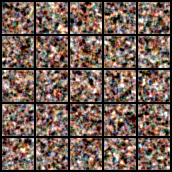

No crossing found for mode 2353
No crossing found for mode 2356
No crossing found for mode 2375
No crossing found for mode 2378
No crossing found for mode 2388
No crossing found for mode 2392
No crossing found for mode 2401
No crossing found for mode 2403
No crossing found for mode 2410
No crossing found for mode 2411
No crossing found for mode 2413
No crossing found for mode 2416
No crossing found for mode 2418
No crossing found for mode 2419
No crossing found for mode 2420
No crossing found for mode 2423
No crossing found for mode 2425
No crossing found for mode 2428
No crossing found for mode 2430
No crossing found for mode 2431
No crossing found for mode 2433
No crossing found for mode 2434
No crossing found for mode 2435
No crossing found for mode 2437
No crossing found for mode 2439
No crossing found for mode 2440
No crossing found for mode 2441
No crossing found for mode 2443
No crossing found for mode 2444
No crossing found for mode 2446
No crossing found for mode 2447
No cross

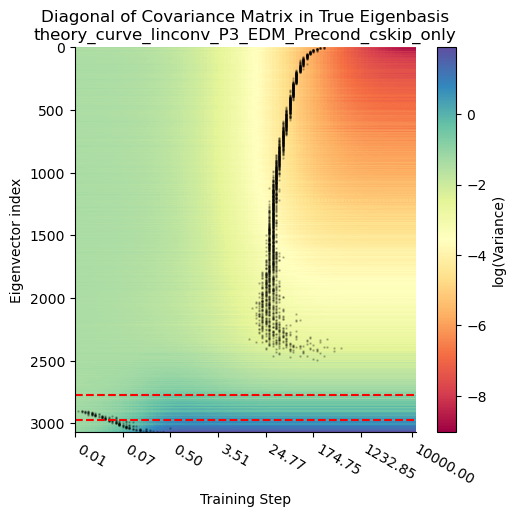

No crossing found for mode 2353
No crossing found for mode 2356
No crossing found for mode 2375
No crossing found for mode 2378
No crossing found for mode 2388
No crossing found for mode 2392
No crossing found for mode 2401
No crossing found for mode 2403
No crossing found for mode 2410
No crossing found for mode 2411
No crossing found for mode 2413
No crossing found for mode 2416
No crossing found for mode 2418
No crossing found for mode 2419
No crossing found for mode 2420
No crossing found for mode 2423
No crossing found for mode 2425
No crossing found for mode 2428
No crossing found for mode 2430
No crossing found for mode 2431
No crossing found for mode 2433
No crossing found for mode 2434
No crossing found for mode 2435
No crossing found for mode 2437
No crossing found for mode 2439
No crossing found for mode 2440
No crossing found for mode 2441
No crossing found for mode 2443
No crossing found for mode 2444
No crossing found for mode 2446
No crossing found for mode 2447
No cross

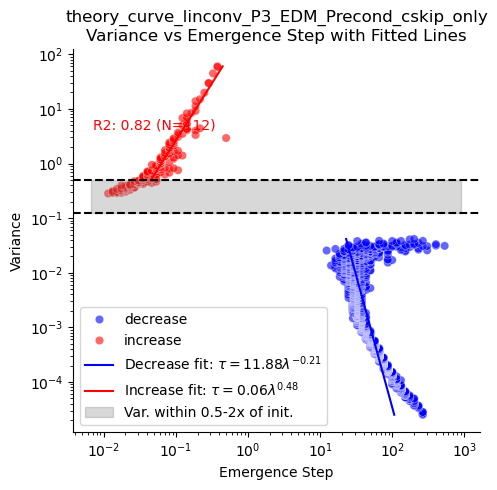

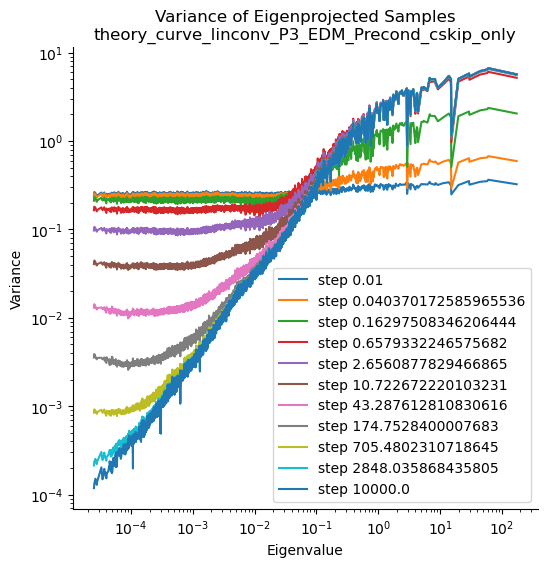

In [43]:
img_eigval = eig_vals.cpu()
diag_cov_x_sample_true_eigenbasis_traj = samples_eigvar_store.cpu()
step_slice = tau_eta_arr
expname = f"theory_curve_linconv_P{P}_EDM_Precond_cskip_only"
mtg = to_imgrid(((1 + samples_store[tau_eta_arr[-1]][:25]) * 0.5).clamp(0, 1), nrow=5)
display(mtg)
mtg.save(join(theory_dir, f"{expname}_final_samples.png"))

emer_time_df = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), range(len(step_slice)), smooth_sigma=1, threshold_type="geometric_mean")
# find the eigen index that the initial variance and final variance are similar
var_ratio = diag_cov_x_sample_true_eigenbasis_traj[0,:] / img_eigval.cpu()
eig_idx_tooclose = (var_ratio > 0.5) & (var_ratio < 2)
eig_idx_tooclose_vec = eig_idx_tooclose.nonzero()[:,0]
plt.figure(figsize=(5.5, 5))
plt.pcolor(diag_cov_x_sample_true_eigenbasis_traj.log().cpu().numpy().T, cmap="Spectral", rasterized=True)
plt.colorbar(label="log(Variance)")
plt.scatter(emer_time_df["emergence_step"].to_numpy(), emer_time_df.index.to_numpy(), marker=".", c="k", s=3, alpha=0.2, rasterized=True)
plt.axhline(eig_idx_tooclose_vec[0], color="r", linestyle="--")
plt.axhline(eig_idx_tooclose_vec[-1], color="r", linestyle="--")
plt.title(f"Diagonal of Covariance Matrix in True Eigenbasis\n{expname}")
plt.xlabel("Training Step")
plt.ylabel("Eigenvector index")
plt.gca().invert_yaxis()  # Flip the y-axis
# annotate x-axis with step_slice
# Only show a subset of ticks to avoid overcrowding
tick_indices = np.linspace(0, len(step_slice)-1, 8, dtype=int)
plt.xticks(tick_indices, ["%.2f"%step_slice[i] for i in tick_indices], rotation=-30, ha="left")
saveallforms([theory_dir], f"eigenframe_variance_heatmap_{expname}_rasterized", dpi=300)
plt.show()
#%
emer_time_df_step = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), step_slice, smooth_sigma=1, threshold_type="geometric_mean")
# emer_time_df_step.to_csv(join(synopsis_dir, f"emergence_time_df_step_{expname}.csv"))
init_var = diag_cov_x_sample_true_eigenbasis_traj[0,:]
mean_init_var = init_var.mean().item()
exclude_mask = (emer_time_df_step.Variance / mean_init_var > 0.5) & (emer_time_df_step.Variance / mean_init_var < 2)

analyze_and_plot_variance(emer_time_df_step, x_col="emergence_step", y_col="Variance", hue_col="Direction", log_x=True, log_y=True, figsize=(5, 5), 
                        exclude_mask=exclude_mask, reverse_equation=True, fit_label_format='{direction} fit: $\\tau = {a:.2f} \lambda^{{{b:.2f}}}$', 
                        title=f'{expname}\nVariance vs Emergence Step with Fitted Lines', xlabel='Emergence Step', ylabel='Variance', 
                        alpha=0.6, annotate=False, annotate_offset=(0, 0), fit_line_kwargs=None, 
                        scatter_kwargs={"rasterized": True, "linewidth": 0.3}, 
                        ax=None,
                        )
plt.axhline(0.5 * mean_init_var, color="k", linestyle="--")
plt.axhline(2 * mean_init_var, color="k", linestyle="--")
# fill the area between the two lines
XLIM = plt.gca().get_xlim()
plt.fill_betweenx([0.5 * mean_init_var, 2 * mean_init_var], [XLIM[0], XLIM[0]], [XLIM[1], XLIM[1]], 
                color="gray", alpha=0.3, label="Var. within 0.5-2x of init.")
print("Direction: increase",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'increase'")
if len(df_split) > 0:
    fit_dict_increase = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)
    # annotate the R2 of the fit
    plt.text(0.05, 0.8, f"R2: {fit_dict_increase['r_squared']:.2f} (N={fit_dict_increase['N']})", transform=plt.gca().transAxes, ha="left", va="center", color="r")
print("Direction: decrease",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'decrease'")
if len(df_split) > 0:
    fit_dict_decrease = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)

plt.legend()
saveallforms([theory_dir], f"convergence_time_vs_variance_scaling_{expname}_rasterized", dpi=300)
plt.show()

plt.figure(figsize=(6, 6))
for step_id in [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, len(step_slice)-1]:
    if step_id < len(step_slice):
        plt.plot(img_eigval.cpu().numpy(), 
                diag_cov_x_sample_true_eigenbasis_traj.cpu().numpy()[step_id,:], 
                label=f"step {step_slice[step_id]}")
plt.xscale("log")
plt.yscale("log")
plt.xlabel("Eigenvalue")
plt.ylabel("Variance")
plt.title(f"Variance of Eigenprojected Samples\n{expname}")
plt.legend()
saveallforms([theory_dir], f"generated_spectral_evolution_{expname}", dpi=300)
plt.show()

### Small size P=5

In [44]:
Xtsr32_5000 = Xtsr_raw[:5000] # this is after preprocessing
P = 5
# noise_level = 5.0
device = "cpu"
X = Xtsr32_5000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
# denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
# train_patche_bank = X_patches_flatten.to(torch.float16).cuda()

torch.Size([5000, 75, 1024])


In [45]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
identity_W = W_center_init.clone()
# learning rate * time
tau_eta = 0.25
samples_store = {}
tau_eta_arr = np.logspace(-2, 4, 100)
for tau_eta in tau_eta_arr: #[0.01, 0.05, 0.1, 0.25, 0.5, 1.0, 2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0, 500.0, 1000.0]:
    linconv_denoiser_learned_dict = {}
    for noise_level in t_steps:
        c_skip, c_out = compute_edm_precond_coeff(noise_level, sigma_data=0.5)
        denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device, verbose=False)
        # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
        shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
        W_residual = (c_skip * identity_W - W_center_optimal) #+ c_out * W_center_init
        # W_residual = (c_skip * identity_W - W_center_optimal) #+ c_out * W_center_init
        residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
        residual_learning = residual_learning.view(C_in, C_in, P, P)
        W_center_learned = W_center_optimal + residual_learning
        # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
        b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
        # build conv model
        conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
        conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
        conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
        linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)
    latents = torch.randn(2048, 3, 32, 32, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, latents, 
                            num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    # print(f"patch size = {P}, tau_eta: {tau_eta}")
    # display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1)[:25], nrow=5))
    samples_store[tau_eta] = samples

In [46]:
samples_eigvar_store = []
for tau_eta in samples_store.keys():
    samples = samples_store[tau_eta]
    samples_eigproj = samples.flatten(start_dim=1) @ eig_vecs
    samples_eigvar = torch.var(samples_eigproj, dim=0)
    samples_eigvar_store.append(samples_eigvar)
samples_eigvar_store = torch.stack(samples_eigvar_store)

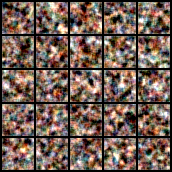

No crossing found for mode 2451
No crossing found for mode 2462
No crossing found for mode 2485
No crossing found for mode 2505
No crossing found for mode 2509
No crossing found for mode 2518
No crossing found for mode 2522
No crossing found for mode 2533
No crossing found for mode 2541
No crossing found for mode 2542
No crossing found for mode 2543
No crossing found for mode 2544
No crossing found for mode 2545
No crossing found for mode 2549
No crossing found for mode 2551
No crossing found for mode 2552
No crossing found for mode 2553
No crossing found for mode 2555
No crossing found for mode 2556
No crossing found for mode 2557
No crossing found for mode 2564
No crossing found for mode 2566
No crossing found for mode 2571
No crossing found for mode 2574
No crossing found for mode 2575
No crossing found for mode 2577
No crossing found for mode 2578
No crossing found for mode 2579
No crossing found for mode 2582
No crossing found for mode 2583
No crossing found for mode 2585
No cross

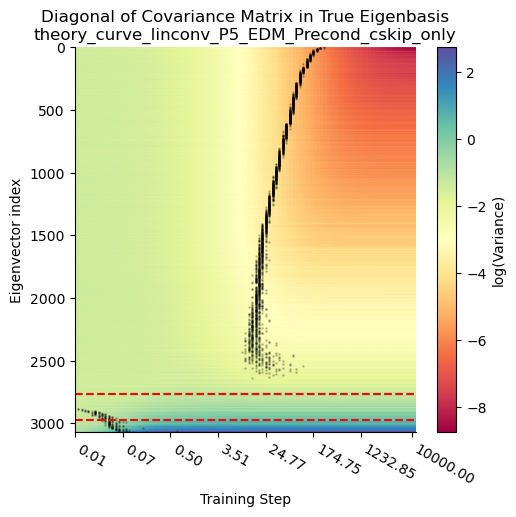

No crossing found for mode 2451
No crossing found for mode 2462
No crossing found for mode 2485
No crossing found for mode 2505
No crossing found for mode 2509
No crossing found for mode 2518
No crossing found for mode 2522
No crossing found for mode 2533
No crossing found for mode 2541
No crossing found for mode 2542
No crossing found for mode 2543
No crossing found for mode 2544
No crossing found for mode 2545
No crossing found for mode 2549
No crossing found for mode 2551
No crossing found for mode 2552
No crossing found for mode 2553
No crossing found for mode 2555
No crossing found for mode 2556
No crossing found for mode 2557
No crossing found for mode 2564
No crossing found for mode 2566
No crossing found for mode 2571
No crossing found for mode 2574
No crossing found for mode 2575
No crossing found for mode 2577
No crossing found for mode 2578
No crossing found for mode 2579
No crossing found for mode 2582
No crossing found for mode 2583
No crossing found for mode 2585
No cross

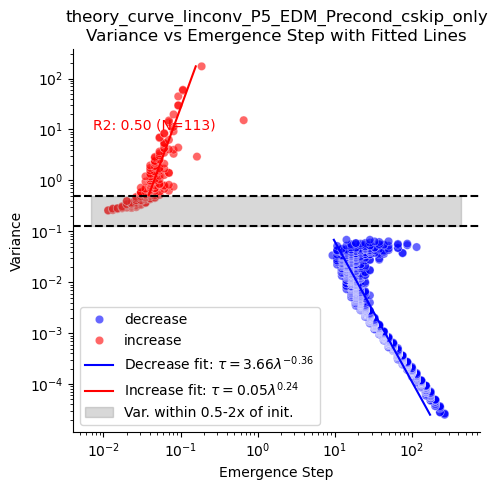

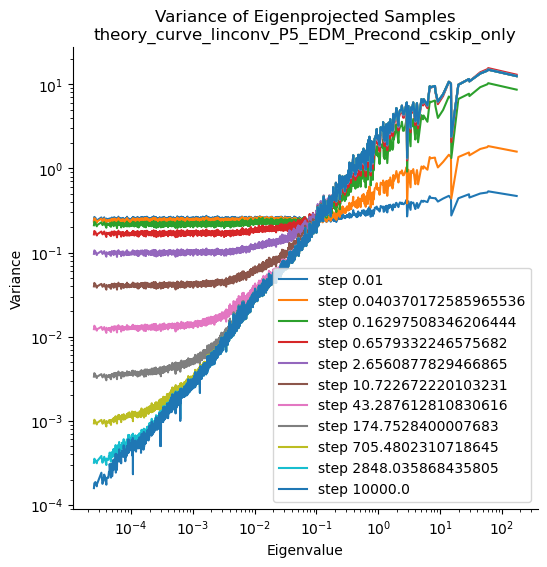

In [47]:
img_eigval = eig_vals.cpu()
diag_cov_x_sample_true_eigenbasis_traj = samples_eigvar_store.cpu()
step_slice = tau_eta_arr
expname = f"theory_curve_linconv_P{P}_EDM_Precond_cskip_only"
mtg = to_imgrid(((1 + samples_store[tau_eta_arr[-1]][:25]) * 0.5).clamp(0, 1), nrow=5)
display(mtg)
mtg.save(join(theory_dir, f"{expname}_final_samples.png"))

emer_time_df = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), range(len(step_slice)), smooth_sigma=1, threshold_type="geometric_mean")
# find the eigen index that the initial variance and final variance are similar
var_ratio = diag_cov_x_sample_true_eigenbasis_traj[0,:] / img_eigval.cpu()
eig_idx_tooclose = (var_ratio > 0.5) & (var_ratio < 2)
eig_idx_tooclose_vec = eig_idx_tooclose.nonzero()[:,0]
plt.figure(figsize=(5.5, 5))
plt.pcolor(diag_cov_x_sample_true_eigenbasis_traj.log().cpu().numpy().T, cmap="Spectral", rasterized=True)
plt.colorbar(label="log(Variance)")
plt.scatter(emer_time_df["emergence_step"].to_numpy(), emer_time_df.index.to_numpy(), marker=".", c="k", s=3, alpha=0.2, rasterized=True)
plt.axhline(eig_idx_tooclose_vec[0], color="r", linestyle="--")
plt.axhline(eig_idx_tooclose_vec[-1], color="r", linestyle="--")
plt.title(f"Diagonal of Covariance Matrix in True Eigenbasis\n{expname}")
plt.xlabel("Training Step")
plt.ylabel("Eigenvector index")
plt.gca().invert_yaxis()  # Flip the y-axis
# annotate x-axis with step_slice
# Only show a subset of ticks to avoid overcrowding
tick_indices = np.linspace(0, len(step_slice)-1, 8, dtype=int)
plt.xticks(tick_indices, ["%.2f"%step_slice[i] for i in tick_indices], rotation=-30, ha="left")
saveallforms([theory_dir], f"eigenframe_variance_heatmap_{expname}_rasterized", dpi=300)
plt.show()
#%
emer_time_df_step = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), step_slice, smooth_sigma=1, threshold_type="geometric_mean")
# emer_time_df_step.to_csv(join(synopsis_dir, f"emergence_time_df_step_{expname}.csv"))
init_var = diag_cov_x_sample_true_eigenbasis_traj[0,:]
mean_init_var = init_var.mean().item()
exclude_mask = (emer_time_df_step.Variance / mean_init_var > 0.5) & (emer_time_df_step.Variance / mean_init_var < 2)

analyze_and_plot_variance(emer_time_df_step, x_col="emergence_step", y_col="Variance", hue_col="Direction", log_x=True, log_y=True, figsize=(5, 5), 
                        exclude_mask=exclude_mask, reverse_equation=True, fit_label_format='{direction} fit: $\\tau = {a:.2f} \lambda^{{{b:.2f}}}$', 
                        title=f'{expname}\nVariance vs Emergence Step with Fitted Lines', xlabel='Emergence Step', ylabel='Variance', 
                        alpha=0.6, annotate=False, annotate_offset=(0, 0), fit_line_kwargs=None, 
                        scatter_kwargs={"rasterized": True, "linewidth": 0.3}, 
                        ax=None,
                        )
plt.axhline(0.5 * mean_init_var, color="k", linestyle="--")
plt.axhline(2 * mean_init_var, color="k", linestyle="--")
# fill the area between the two lines
XLIM = plt.gca().get_xlim()
plt.fill_betweenx([0.5 * mean_init_var, 2 * mean_init_var], [XLIM[0], XLIM[0]], [XLIM[1], XLIM[1]], 
                color="gray", alpha=0.3, label="Var. within 0.5-2x of init.")
print("Direction: increase",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'increase'")
if len(df_split) > 0:
    fit_dict_increase = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)
    # annotate the R2 of the fit
    plt.text(0.05, 0.8, f"R2: {fit_dict_increase['r_squared']:.2f} (N={fit_dict_increase['N']})", transform=plt.gca().transAxes, ha="left", va="center", color="r")
print("Direction: decrease",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'decrease'")
if len(df_split) > 0:
    fit_dict_decrease = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)

plt.legend()
saveallforms([theory_dir], f"convergence_time_vs_variance_scaling_{expname}_rasterized", dpi=300)
plt.show()

plt.figure(figsize=(6, 6))
for step_id in [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, len(step_slice)-1]:
    if step_id < len(step_slice):
        plt.plot(img_eigval.cpu().numpy(), 
                diag_cov_x_sample_true_eigenbasis_traj.cpu().numpy()[step_id,:], 
                label=f"step {step_slice[step_id]}")
plt.xscale("log")
plt.yscale("log")
plt.xlabel("Eigenvalue")
plt.ylabel("Variance")
plt.title(f"Variance of Eigenprojected Samples\n{expname}")
plt.legend()
saveallforms([theory_dir], f"generated_spectral_evolution_{expname}", dpi=300)
plt.show()

### Control version

In [ ]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
identity_W = W_center_init.clone()
# learning rate * time
tau_eta = 0.25
samples_store = {}
tau_eta_arr = np.logspace(-2, 4, 100)
for tau_eta in tau_eta_arr: #[0.01, 0.05, 0.1, 0.25, 0.5, 1.0, 2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0, 500.0, 1000.0]:
    linconv_denoiser_learned_dict = {}
    for noise_level in t_steps:
        c_skip, c_out = compute_edm_precond_coeff(noise_level, sigma_data=0.5)
        denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device, verbose=False)
        # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
        shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
        W_residual = (c_skip * identity_W + c_out * W_center_init - W_center_optimal) #
        # W_residual = (c_skip * identity_W - W_center_optimal) #+ c_out * W_center_init
        residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
        residual_learning = residual_learning.view(C_in, C_in, P, P)
        W_center_learned = W_center_optimal + residual_learning
        # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
        b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
        # build conv model
        conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
        conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
        conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
        linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)
    latents = torch.randn(2048, 3, 32, 32, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, latents, 
                            num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    # print(f"patch size = {P}, tau_eta: {tau_eta}")
    # display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1)[:25], nrow=5))
    samples_store[tau_eta] = samples

In [ ]:
samples_eigvar_store = []
for tau_eta in samples_store.keys():
    samples = samples_store[tau_eta]
    samples_eigproj = samples.flatten(start_dim=1) @ eig_vecs
    samples_eigvar = torch.var(samples_eigproj, dim=0)
    samples_eigvar_store.append(samples_eigvar)
samples_eigvar_store = torch.stack(samples_eigvar_store)

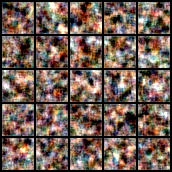

No crossing found for mode 3012
No crossing found for mode 3027
No crossing found for mode 3029
No crossing found for mode 3030
No crossing found for mode 3031
No crossing found for mode 3033
No crossing found for mode 3034
No crossing found for mode 3035
No crossing found for mode 3036
No crossing found for mode 3039
No crossing found for mode 3040
No crossing found for mode 3042
No crossing found for mode 3046
No crossing found for mode 3049
No crossing found for mode 3052
No crossing found for mode 3054
No crossing found for mode 3056
No crossing found for mode 3057
No crossing found for mode 3058
No crossing found for mode 3059
No crossing found for mode 3061
No crossing found for mode 3064
No crossing found for mode 3065
No crossing found for mode 3066
No crossing found for mode 3067
No crossing found for mode 3068
No crossing found for mode 3069
No crossing found for mode 3070
No crossing found for mode 3071


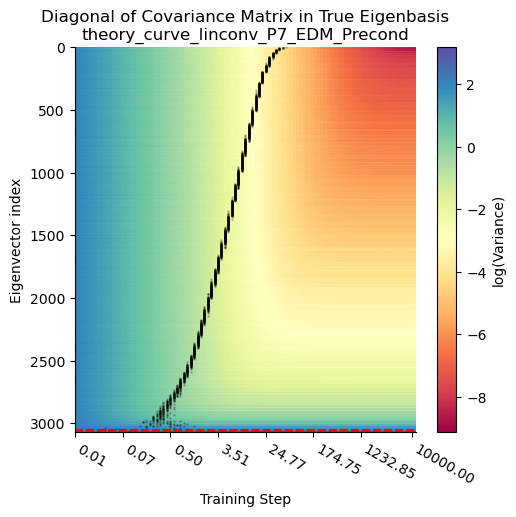

No crossing found for mode 3012
No crossing found for mode 3027
No crossing found for mode 3029
No crossing found for mode 3030
No crossing found for mode 3031
No crossing found for mode 3033
No crossing found for mode 3034
No crossing found for mode 3035
No crossing found for mode 3036
No crossing found for mode 3039
No crossing found for mode 3040
No crossing found for mode 3042
No crossing found for mode 3046
No crossing found for mode 3049
No crossing found for mode 3052
No crossing found for mode 3054
No crossing found for mode 3056
No crossing found for mode 3057
No crossing found for mode 3058
No crossing found for mode 3059
No crossing found for mode 3061
No crossing found for mode 3064
No crossing found for mode 3065
No crossing found for mode 3066
No crossing found for mode 3067
No crossing found for mode 3068
No crossing found for mode 3069
No crossing found for mode 3070
No crossing found for mode 3071
Not enough data points to fit for direction: nan
Not enough data points 

/n/home12/binxuwang/.conda/envs/torch2/lib/python3.10/site-packages/sklearn/metrics/_regression.py:1266: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


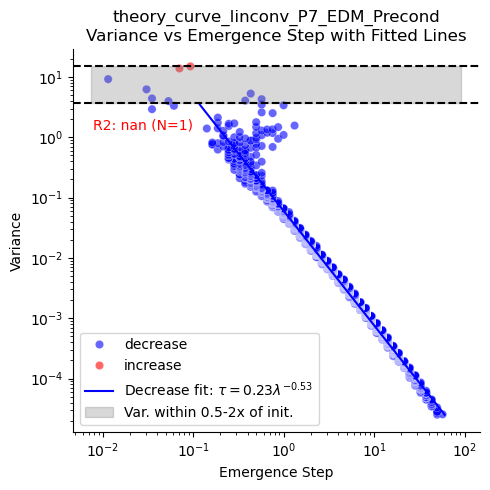

In [23]:
img_eigval = eig_vals.cpu()
diag_cov_x_sample_true_eigenbasis_traj = samples_eigvar_store.cpu()
step_slice = tau_eta_arr
expname = f"theory_curve_linconv_P{P}_EDM_Precond"
mtg = to_imgrid(((1 + samples_store[tau_eta_arr[-1]][:25]) * 0.5).clamp(0, 1), nrow=5)
display(mtg)
mtg.save(join(theory_dir, f"{expname}_final_samples.png"))

emer_time_df = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), range(len(step_slice)), smooth_sigma=1, threshold_type="geometric_mean")
# find the eigen index that the initial variance and final variance are similar
var_ratio = diag_cov_x_sample_true_eigenbasis_traj[0,:] / img_eigval.cpu()
eig_idx_tooclose = (var_ratio > 0.5) & (var_ratio < 2)
eig_idx_tooclose_vec = eig_idx_tooclose.nonzero()[:,0]
plt.figure(figsize=(5.5, 5))
plt.pcolor(diag_cov_x_sample_true_eigenbasis_traj.log().cpu().numpy().T, cmap="Spectral", rasterized=True)
plt.colorbar(label="log(Variance)")
plt.scatter(emer_time_df["emergence_step"].to_numpy(), emer_time_df.index.to_numpy(), marker=".", c="k", s=3, alpha=0.2, rasterized=True)
plt.axhline(eig_idx_tooclose_vec[0], color="r", linestyle="--")
plt.axhline(eig_idx_tooclose_vec[-1], color="r", linestyle="--")
plt.title(f"Diagonal of Covariance Matrix in True Eigenbasis\n{expname}")
plt.xlabel("Training Step")
plt.ylabel("Eigenvector index")
plt.gca().invert_yaxis()  # Flip the y-axis
# annotate x-axis with step_slice
# Only show a subset of ticks to avoid overcrowding
tick_indices = np.linspace(0, len(step_slice)-1, 8, dtype=int)
plt.xticks(tick_indices, ["%.2f"%step_slice[i] for i in tick_indices], rotation=-30, ha="left")
saveallforms([theory_dir], f"eigenframe_variance_heatmap_{expname}_rasterized", dpi=300)
plt.show()
#%
emer_time_df_step = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), step_slice, smooth_sigma=1, threshold_type="geometric_mean")
# emer_time_df_step.to_csv(join(synopsis_dir, f"emergence_time_df_step_{expname}.csv"))
init_var = diag_cov_x_sample_true_eigenbasis_traj[0,:]
mean_init_var = init_var.mean().item()
exclude_mask = (emer_time_df_step.Variance / mean_init_var > 0.5) & (emer_time_df_step.Variance / mean_init_var < 2)

analyze_and_plot_variance(emer_time_df_step, x_col="emergence_step", y_col="Variance", hue_col="Direction", log_x=True, log_y=True, figsize=(5, 5), 
                        exclude_mask=exclude_mask, reverse_equation=True, fit_label_format='{direction} fit: $\\tau = {a:.2f} \lambda^{{{b:.2f}}}$', 
                        title=f'{expname}\nVariance vs Emergence Step with Fitted Lines', xlabel='Emergence Step', ylabel='Variance', 
                        alpha=0.6, annotate=False, annotate_offset=(0, 0), fit_line_kwargs=None, 
                        scatter_kwargs={"rasterized": True, "linewidth": 0.3}, 
                        ax=None,
                        )
plt.axhline(0.5 * mean_init_var, color="k", linestyle="--")
plt.axhline(2 * mean_init_var, color="k", linestyle="--")
# fill the area between the two lines
XLIM = plt.gca().get_xlim()
plt.fill_betweenx([0.5 * mean_init_var, 2 * mean_init_var], [XLIM[0], XLIM[0]], [XLIM[1], XLIM[1]], 
                color="gray", alpha=0.3, label="Var. within 0.5-2x of init.")
print("Direction: increase",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'increase'")
if len(df_split) > 0:
    fit_dict_increase = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)
    # annotate the R2 of the fit
    plt.text(0.05, 0.8, f"R2: {fit_dict_increase['r_squared']:.2f} (N={fit_dict_increase['N']})", transform=plt.gca().transAxes, ha="left", va="center", color="r")
print("Direction: decrease",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'decrease'")
if len(df_split) > 0:
    fit_dict_decrease = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)

plt.legend()
saveallforms([theory_dir], f"convergence_time_vs_variance_scaling_{expname}_rasterized", dpi=300)
plt.show()

## Some experiments: FFHQ32_UNet_CNN_EDM_1blocks_1x_wide128_fixednorm

In [55]:

from core.img_patch_stats_analysis_lib import compute_crossing_points, sweep_and_create_sample_store, process_img_mean_cov_statistics,\
     process_patch_mean_cov_statistics, plot_variance_trajectories, plot_mean_deviation_trajectories, \
     harmonic_mean, smooth_and_find_threshold_crossing
from core.trajectory_convergence_lib import analyze_and_plot_variance
from core.trajectory_convergence_lib import smooth_and_find_threshold_crossing, compute_crossing_points
from core.img_patch_stats_analysis_lib import plot_variance_trajectories

In [56]:
#%% Load in the Sample Stores FFHQ MLP 
Xtsr, imgsize = load_dataset("ffhq-32x32", normalize=True)
exproot = r"/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiffusionSpectralLearningCurve/"
expname = "FFHQ32_UNet_CNN_EDM_1blocks_1x_wide128_fixednorm"
savedir = join(exproot, expname)
figdir = join(savedir, "figures")
os.makedirs(figdir, exist_ok=True)
sampledir = join(savedir, "samples")
sample_store = sweep_and_create_sample_store(sampledir)
#%%
imgshape = (3, 32, 32)
patch_size, patch_stride = 32, 1
step_slice = sorted(sample_store.keys())
img_mean, img_cov, img_eigval, img_eigvec, mean_x_sample_traj, cov_x_sample_traj, diag_cov_x_sample_true_eigenbasis_traj = \
     process_img_mean_cov_statistics(Xtsr, sample_store, savedir, device="cuda", imgshape=imgshape, save_pkl=False)

/n/home12/binxuwang/Github/DiffusionLearningCurve/core/dataset_lib.py:47: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  Xtsr_raw = torch.load(join(word_dataset_root, "ffhq-3

ffhq-32x32 dataset: torch.Size([70000, 3, 32, 32])
Raw value range 1.0 0.0
Normalizing dataset to [-1.0, 1.0]


  0%|          | 0/494 [00:00<?, ?it/s]

/n/home12/binxuwang/Github/DiffusionLearningCurve/core/img_patch_stats_analysis_lib.py:49: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  sample_store[epoch] = torch.load(sam

img_cov.shape: torch.Size([3072, 3072]) computed on 70000 images


  0%|          | 0/494 [00:00<?, ?it/s]

No crossing found for mode 160
No crossing found for mode 175
No crossing found for mode 177
No crossing found for mode 183
No crossing found for mode 188
No crossing found for mode 189
No crossing found for mode 190
No crossing found for mode 193
No crossing found for mode 195
No crossing found for mode 199
No crossing found for mode 214


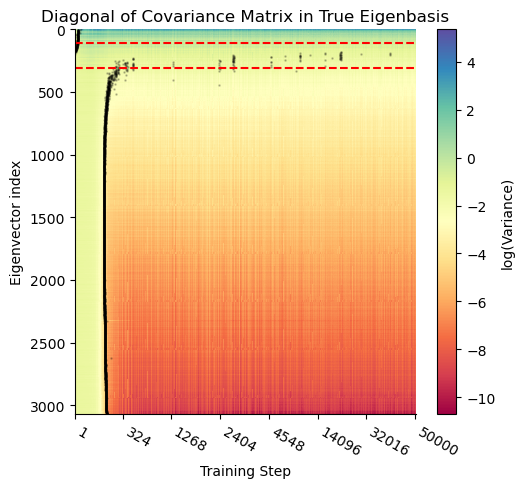

In [58]:
emer_time_df = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), range(len(step_slice)), smooth_sigma=1, threshold_type="geometric_mean")
# find the eigen index that the initial variance and final variance are similar
var_ratio = diag_cov_x_sample_true_eigenbasis_traj[0,:] / img_eigval.cpu()
eig_idx_tooclose = (var_ratio > 0.5) & (var_ratio < 2)
eig_idx_tooclose_vec = eig_idx_tooclose.nonzero()[:,0]
plt.figure(figsize=(5.5, 5))
plt.pcolor(diag_cov_x_sample_true_eigenbasis_traj.log().cpu().numpy().T, cmap="Spectral", rasterized=True)
plt.colorbar(label="log(Variance)")
plt.scatter(emer_time_df["emergence_step"].to_numpy(), emer_time_df.index.to_numpy(), marker=".", c="k", s=3, alpha=0.2, rasterized=True)
plt.axhline(eig_idx_tooclose_vec[0], color="r", linestyle="--")
plt.axhline(eig_idx_tooclose_vec[-1], color="r", linestyle="--")
plt.title("Diagonal of Covariance Matrix in True Eigenbasis")
plt.xlabel("Training Step")
plt.ylabel("Eigenvector index")
plt.gca().invert_yaxis()  # Flip the y-axis
# annotate x-axis with step_slice
# Only show a subset of ticks to avoid overcrowding
tick_indices = np.linspace(0, len(step_slice)-1, 8, dtype=int)
plt.xticks(tick_indices, [step_slice[i] for i in tick_indices], rotation=-30, ha="left")
saveallforms(figdir, f"eigenframe_variance_heatmap_{expname}_rasterized", dpi=300)
plt.show()

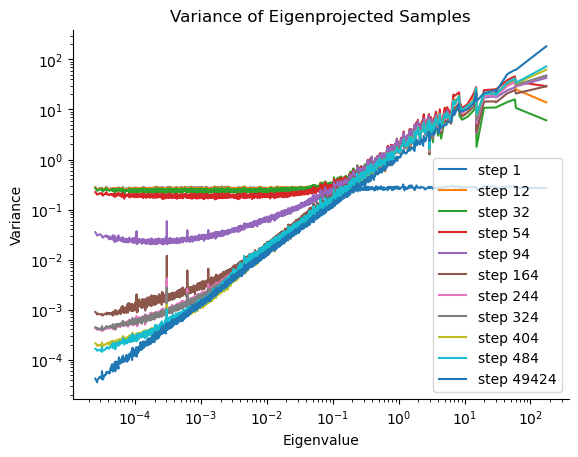

In [63]:
for step_id in [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 490]:
    plt.plot(img_eigval.cpu().numpy(), 
             diag_cov_x_sample_true_eigenbasis_traj.cpu().numpy()[step_id,:], 
             label=f"step {step_slice[step_id]}")
plt.xscale("log")
plt.yscale("log")
plt.xlabel("Eigenvalue")
plt.ylabel("Variance")
plt.title("Variance of Eigenprojected Samples")
plt.legend()
plt.show()

### Check really shallow ResNet

In [71]:
#%% Load in the Sample Stores FFHQ MLP 
Xtsr, imgsize = load_dataset("ffhq-32x32", normalize=True)
exproot = r"/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiffusionSpectralLearningCurve/"
expname = "FFHQ32_ResNet_CNN_EDM_1layers_wide256"
savedir = join(exproot, expname)
figdir = join(savedir, "figures")
os.makedirs(figdir, exist_ok=True)
sampledir = join(savedir, "samples")
sample_store = sweep_and_create_sample_store(sampledir)
#%%
imgshape = (3, 32, 32)
patch_size, patch_stride = 32, 1
step_slice = sorted(sample_store.keys())
img_mean, img_cov, img_eigval, img_eigvec, mean_x_sample_traj, cov_x_sample_traj, diag_cov_x_sample_true_eigenbasis_traj = \
     process_img_mean_cov_statistics(Xtsr, sample_store, savedir, device="cuda", imgshape=imgshape, save_pkl=False)

/n/home12/binxuwang/Github/DiffusionLearningCurve/core/dataset_lib.py:47: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  Xtsr_raw = torch.load(join(word_dataset_root, "ffhq-3

ffhq-32x32 dataset: torch.Size([70000, 3, 32, 32])
Raw value range 1.0 0.0
Normalizing dataset to [-1.0, 1.0]


  0%|          | 0/235 [00:00<?, ?it/s]

/n/home12/binxuwang/Github/DiffusionLearningCurve/core/img_patch_stats_analysis_lib.py:49: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  sample_store[epoch] = torch.load(sam

img_cov.shape: torch.Size([3072, 3072]) computed on 70000 images


  0%|          | 0/235 [00:00<?, ?it/s]

No crossing found for mode 160
No crossing found for mode 168
No crossing found for mode 169
No crossing found for mode 170
No crossing found for mode 171
No crossing found for mode 173
No crossing found for mode 174
No crossing found for mode 175
No crossing found for mode 176
No crossing found for mode 177
No crossing found for mode 178
No crossing found for mode 179
No crossing found for mode 180
No crossing found for mode 181
No crossing found for mode 182
No crossing found for mode 183
No crossing found for mode 184
No crossing found for mode 185
No crossing found for mode 186
No crossing found for mode 187
No crossing found for mode 188
No crossing found for mode 189
No crossing found for mode 190
No crossing found for mode 191
No crossing found for mode 192
No crossing found for mode 193
No crossing found for mode 194
No crossing found for mode 195
No crossing found for mode 196
No crossing found for mode 197
No crossing found for mode 198
No crossing found for mode 199
No cross

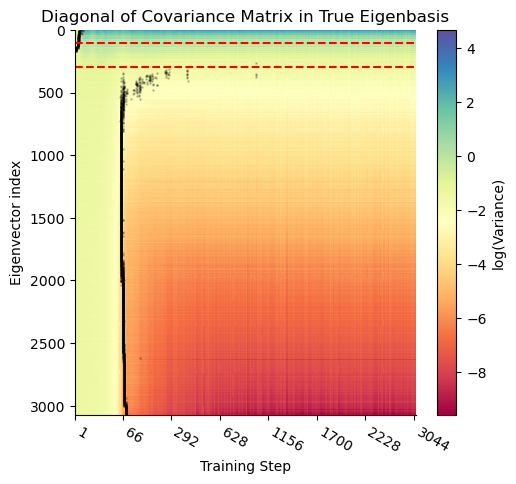

In [72]:
emer_time_df = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), range(len(step_slice)), smooth_sigma=1, threshold_type="geometric_mean")
# find the eigen index that the initial variance and final variance are similar
var_ratio = diag_cov_x_sample_true_eigenbasis_traj[0,:] / img_eigval.cpu()
eig_idx_tooclose = (var_ratio > 0.5) & (var_ratio < 2)
eig_idx_tooclose_vec = eig_idx_tooclose.nonzero()[:,0]
plt.figure(figsize=(5.5, 5))
plt.pcolor(diag_cov_x_sample_true_eigenbasis_traj.log().cpu().numpy().T, cmap="Spectral", rasterized=True)
plt.colorbar(label="log(Variance)")
plt.scatter(emer_time_df["emergence_step"].to_numpy(), emer_time_df.index.to_numpy(), marker=".", c="k", s=3, alpha=0.2, rasterized=True)
plt.axhline(eig_idx_tooclose_vec[0], color="r", linestyle="--")
plt.axhline(eig_idx_tooclose_vec[-1], color="r", linestyle="--")
plt.title("Diagonal of Covariance Matrix in True Eigenbasis")
plt.xlabel("Training Step")
plt.ylabel("Eigenvector index")
plt.gca().invert_yaxis()  # Flip the y-axis
# annotate x-axis with step_slice
# Only show a subset of ticks to avoid overcrowding
tick_indices = np.linspace(0, len(step_slice)-1, 8, dtype=int)
plt.xticks(tick_indices, [step_slice[i] for i in tick_indices], rotation=-30, ha="left")
saveallforms(figdir, f"eigenframe_variance_heatmap_{expname}_rasterized", dpi=300)
plt.show()

No crossing found for mode 177
No crossing found for mode 180
No crossing found for mode 181
No crossing found for mode 183
No crossing found for mode 184
No crossing found for mode 185
No crossing found for mode 186
No crossing found for mode 187
No crossing found for mode 188
No crossing found for mode 189
No crossing found for mode 190
No crossing found for mode 191
No crossing found for mode 192
No crossing found for mode 193
No crossing found for mode 194
No crossing found for mode 195
No crossing found for mode 196
No crossing found for mode 197
No crossing found for mode 198
No crossing found for mode 199
No crossing found for mode 200
No crossing found for mode 201
No crossing found for mode 202
No crossing found for mode 203
No crossing found for mode 204
No crossing found for mode 205
No crossing found for mode 206
No crossing found for mode 207
No crossing found for mode 208
No crossing found for mode 209
No crossing found for mode 210
No crossing found for mode 211
No cross

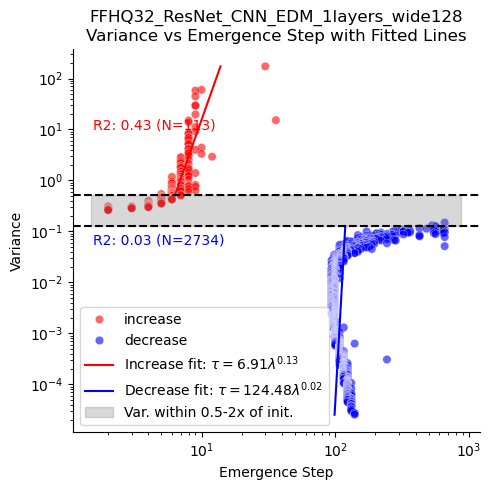

In [70]:
emer_time_df_step = compute_crossing_points(img_eigval.cpu(), diag_cov_x_sample_true_eigenbasis_traj.cpu(), step_slice, smooth_sigma=1, threshold_type="geometric_mean")

init_var = diag_cov_x_sample_true_eigenbasis_traj[0,:]
mean_init_var = init_var.mean().item()
exclude_mask = (emer_time_df_step.Variance / mean_init_var > 0.5) & (emer_time_df_step.Variance / mean_init_var < 2)

analyze_and_plot_variance(emer_time_df_step, x_col="emergence_step", y_col="Variance", hue_col="Direction", log_x=True, log_y=True, figsize=(5, 5), 
                          exclude_mask=exclude_mask, reverse_equation=True, fit_label_format='{direction} fit: $\\tau = {a:.2f} \lambda^{{{b:.2f}}}$', 
                          title=f'{expname}\nVariance vs Emergence Step with Fitted Lines', xlabel='Emergence Step', ylabel='Variance', 
                          alpha=0.6, annotate=False, annotate_offset=(0, 0), fit_line_kwargs=None, 
                          scatter_kwargs={"rasterized": True, "linewidth": 0.3}, 
                          ax=None,
                          )
plt.axhline(0.5 * mean_init_var, color="k", linestyle="--")
plt.axhline(2 * mean_init_var, color="k", linestyle="--")
# fill the area between the two lines
XLIM = plt.gca().get_xlim()
plt.fill_betweenx([0.5 * mean_init_var, 2 * mean_init_var], [XLIM[0], XLIM[0]], [XLIM[1], XLIM[1]], 
                  color="gray", alpha=0.3, label="Var. within 0.5-2x of init.")
print("Direction: increase",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'increase'")
fit_dict_increase = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)
print("Direction: decrease",)
df_split = emer_time_df_step[~exclude_mask].query("Direction == 'decrease'")
fit_dict_decrease = fit_regression_log_scale(df_split.Variance, df_split.emergence_step)
# annotate the R2 of the fit
plt.text(0.05, 0.8, f"R2: {fit_dict_increase['r_squared']:.2f} (N={fit_dict_increase['N']})", transform=plt.gca().transAxes, ha="left", va="center", color="r")
plt.text(0.05, 0.5, f"R2: {fit_dict_decrease['r_squared']:.2f} (N={fit_dict_decrease['N']})", transform=plt.gca().transAxes, ha="left", va="center", color="blue")
plt.legend()
saveallforms(figdir, f"convergence_time_vs_variance_scaling_{expname}_rasterized", dpi=300)
plt.show()

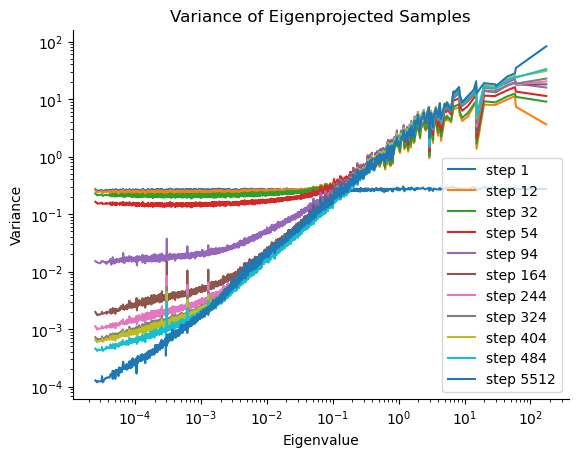

In [68]:
for step_id in [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 300]:
    plt.plot(img_eigval.cpu().numpy(), 
             diag_cov_x_sample_true_eigenbasis_traj.cpu().numpy()[step_id,:], 
             label=f"step {step_slice[step_id]}")
plt.xscale("log")
plt.yscale("log")
plt.xlabel("Eigenvalue")
plt.ylabel("Variance")
plt.title("Variance of Eigenprojected Samples")
plt.legend()
plt.show()

### Load and check the architecture

In [64]:
from core.network_edm_lib import SongUNet, DhariwalUNet, create_unet_model
from core.diffusion_edm_lib import UNetBlockStyleMLP_backbone, EDMPrecondWrapper, EDMCNNPrecondWrapper, EDMDiTPrecondWrapper
import json
from easydict import EasyDict as edict
# model_dict = torch.load(join(expdir, "model_final.pth"))
config = json.load(open(join(savedir, "config.json")))
unet = create_unet_model(edict(config))
unet.load_state_dict(torch.load(join(savedir, "model_final.pth")))
model_precd_CNN = EDMCNNPrecondWrapper(unet, sigma_data=0.5, sigma_min=0.002, sigma_max=80, rho=7.0)
model_precd_CNN = model_precd_CNN.to("cuda").eval();

total number of trainable parameters in the Score Model: 2570243
total number of parameters in the Score Model: 2570243


/tmp/ipykernel_557574/4248832776.py:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  unet.load_state_dict(torch.load(join(savedir, "model_final.pth")))


In [65]:
unet

SongUNet(
  (map_noise): PositionalEmbedding()
  (map_layer0): Linear()
  (map_layer1): Linear()
  (enc): ModuleDict(
    (32x32_conv): Conv2d()
    (32x32_block0): UNetBlock(
      (norm0): GroupNorm()
      (conv0): Conv2d()
      (affine): Linear()
      (norm1): GroupNorm()
      (conv1): Conv2d()
    )
  )
  (dec): ModuleDict(
    (32x32_in0): UNetBlock(
      (norm0): GroupNorm()
      (conv0): Conv2d()
      (affine): Linear()
      (norm1): GroupNorm()
      (conv1): Conv2d()
      (norm2): GroupNorm()
      (qkv): Conv2d()
      (proj): Conv2d()
    )
    (32x32_in1): UNetBlock(
      (norm0): GroupNorm()
      (conv0): Conv2d()
      (affine): Linear()
      (norm1): GroupNorm()
      (conv1): Conv2d()
    )
    (32x32_block0): UNetBlock(
      (norm0): GroupNorm()
      (conv0): Conv2d()
      (affine): Linear()
      (norm1): GroupNorm()
      (conv1): Conv2d()
      (skip): Conv2d()
    )
    (32x32_block1): UNetBlock(
      (norm0): GroupNorm()
      (conv0): Conv2d()
   

## FFHQ64 dataset

In [6]:
import sys
from os.path import join
sys.path.append("/n/home12/binxuwang/Github/edm")
from training.dataset import TensorDataset, ImageFolderDataset
edm_dataset_root = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Datasets/EDM_datasets/datasets"
edm_ffhq64_path = join(edm_dataset_root, "ffhq-64x64.zip")
dataset = ImageFolderDataset(edm_ffhq64_path)

### Playground for demo the linear conv denoisr

In [ ]:
Xtsr64_1000 = fetch_ref_img_tsr(dataset, range(1000)) # this is after preprocessing
P = 17
# noise_level = 5.0
device = "cpu"
X = Xtsr64_1000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
# denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
train_patche_bank = X_patches_flatten.to(torch.float16).cuda()

torch.Size([1000, 867, 4096])


In [12]:
linconv_denoiser_dict = {}
for noise_level in [0.001, 0.01, 0.1, 0.5, 1.0, 2.0, 3.5, 5.0, 10.0, 50.0]:
    denoiser_jacobian, denoiser_bias, W_center, b_center = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device)
    # denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
    # build conv model
    conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
    conv_GaussianPatch.weight.data = W_center
    conv_GaussianPatch.bias.data = b_center
    linconv_denoiser_dict[noise_level] = conv_GaussianPatch

torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])


In [15]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
linconv_denoiser_dict = {}
for noise_level in t_steps:
    denoiser_jacobian, denoiser_bias, W_center, b_center = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device)
    # denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
    # build conv model
    conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
    conv_GaussianPatch.weight.data = W_center.to(device)
    conv_GaussianPatch.bias.data = b_center.to(device)
    linconv_denoiser_dict[noise_level.item()] = conv_GaussianPatch.to(device)

torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size(

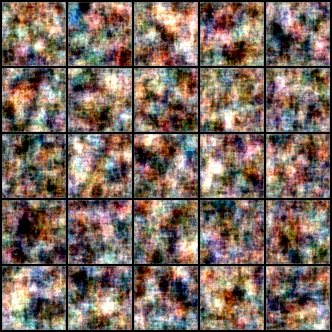

In [16]:
samples = edm_sampler_with_linconv(linconv_denoiser_dict, torch.randn(25, 3, 64, 64).cuda(), 
                         num_steps=35, sigma_min=0.002, sigma_max=80, rho=7)
to_imgrid(((samples + 1) * 0.5).clamp(0, 1), nrow=5)

In [63]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
linconv_denoiser_init_dict = {}
for noise_level in t_steps:
    denoiser_jacobian, denoiser_bias, W_center, b_center = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device)
    # build conv model
    conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
    conv_GaussianPatch.weight.data = W_center_init.to(device)
    conv_GaussianPatch.bias.data = b_center_init.to(device)
    linconv_denoiser_init_dict[noise_level.item()] = conv_GaussianPatch.to(device)

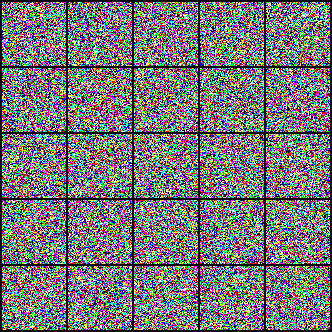

In [64]:
samples = edm_sampler_with_linconv(linconv_denoiser_init_dict, torch.randn(25, 3, 64, 64).cuda(), 
                         num_steps=35, sigma_min=0.002, sigma_max=80, rho=7)
to_imgrid(((samples + 1) * 0.5).clamp(0, 1), nrow=5)

### Learning dynamics

In [67]:
patch_cov.shape

torch.Size([867, 867])

In [10]:
# compute the patch covariance exponential
noise_level = 10
tau_eta = 0.01
shifted_patch_cov = patch_cov + torch.eye(patch_cov.shape[0], device=patch_cov.device) * noise_level ** 2
patch_cov_exp = torch.matrix_exp(- tau_eta * shifted_patch_cov)
patch_cov_exp.shape

NameError: name 'patch_cov' is not defined

In [153]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
# learning rate * time
tau_eta = 0.25
linconv_denoiser_learned_dict = {}
for noise_level in t_steps:
    denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device)
    # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
    shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
    W_residual = (W_center_init - W_center_optimal)
    residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
    residual_learning = residual_learning.view(C_in, C_in, P, P)
    W_center_learned = W_center_optimal + residual_learning
    # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
    b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
    # build conv model
    conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
    conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
    conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
    linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)

torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size([3, 3, 17, 17])
torch.Size([3])
torch.Size(

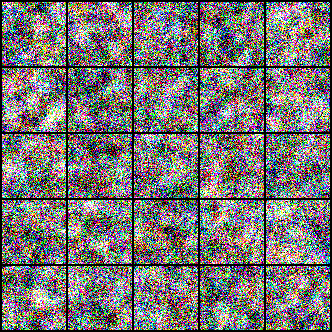

In [155]:
samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, torch.randn(25, 3, 64, 64).cuda(), 
                         num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
to_imgrid(((samples + 1) * 0.5).clamp(0, 1), nrow=5)

### Patch size = 17

In [ ]:
Xtsr64_1000 = fetch_ref_img_tsr(dataset, range(1000))
P = 17
# noise_level = 5.0
device = "cpu"
X = Xtsr64_1000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
# denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
# train_patche_bank = X_patches_flatten.to(torch.float16).cuda()

patch size = 17, tau_eta: 0.01


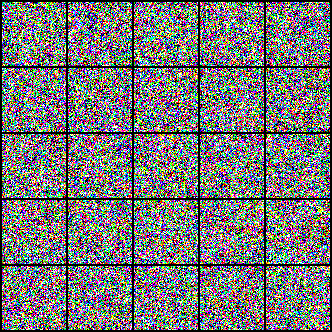

patch size = 17, tau_eta: 0.05


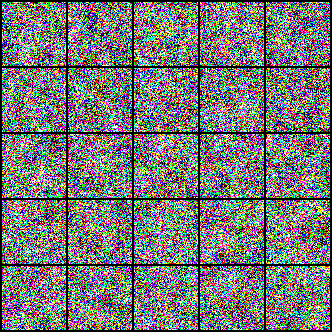

patch size = 17, tau_eta: 0.1


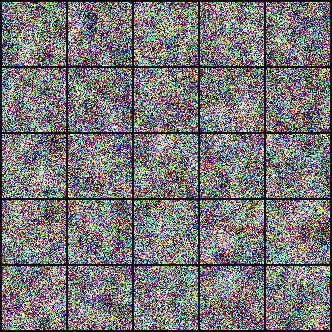

patch size = 17, tau_eta: 0.25


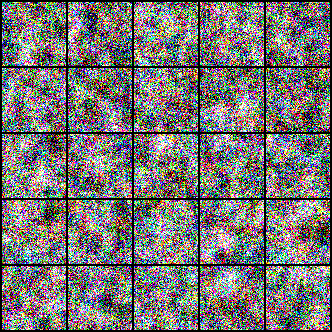

patch size = 17, tau_eta: 0.5


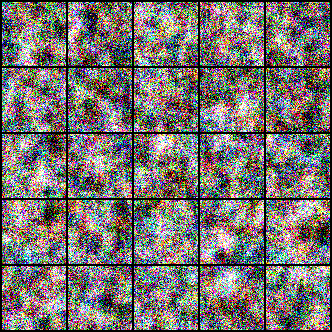

patch size = 17, tau_eta: 1.0


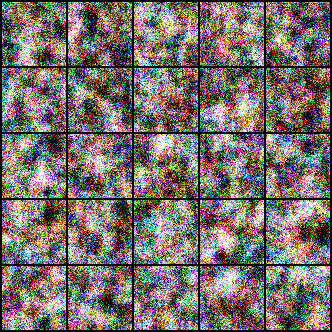

patch size = 17, tau_eta: 2.0


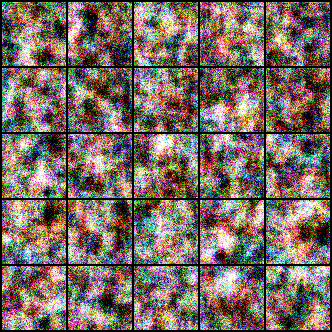

patch size = 17, tau_eta: 5.0


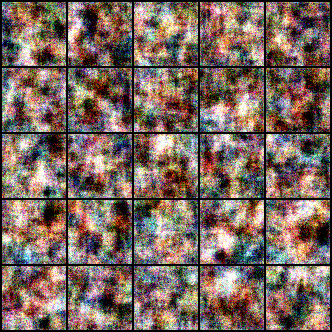

patch size = 17, tau_eta: 10.0


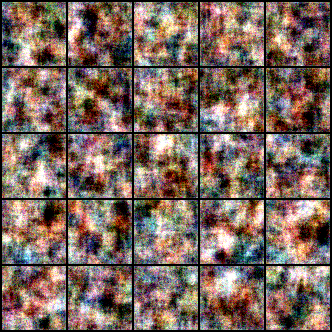

patch size = 17, tau_eta: 100.0


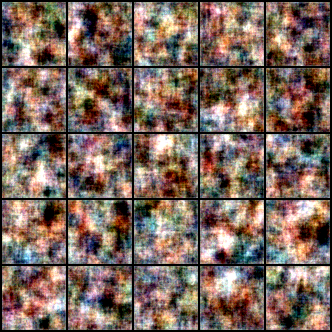

In [20]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
# learning rate * time
tau_eta = 0.25
samples_store = {}
for tau_eta in [0.01, 0.05, 0.1, 0.25, 0.5, 1.0, 2.0, 5.0, 10.0, 100.0]:
    linconv_denoiser_learned_dict = {}
    for noise_level in t_steps:
        denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device, verbose=False)
        # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
        shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
        W_residual = (W_center_init - W_center_optimal)
        residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
        residual_learning = residual_learning.view(C_in, C_in, P, P)
        W_center_learned = W_center_optimal + residual_learning
        # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
        b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
        # build conv model
        conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
        conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
        conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
        linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)
    latents = torch.randn(2048, 3, 64, 64, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, latents, 
                            num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    print(f"patch size = {P}, tau_eta: {tau_eta}")
    display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1)[:25], nrow=5))
    samples_store[tau_eta] = samples

### Patch size = 9 

In [158]:
Xtsr64_1000 = fetch_ref_img_tsr(dataset, range(1000))
P = 9
# noise_level = 5.0
device = "cpu"
X = Xtsr64_1000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
# denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
# train_patche_bank = X_patches_flatten.to(torch.float16).cuda()

torch.Size([1000, 243, 4096])


patch size = 17, tau_eta: 0.01


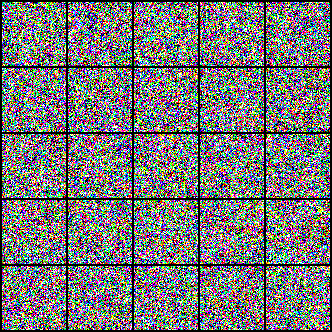

patch size = 17, tau_eta: 0.05


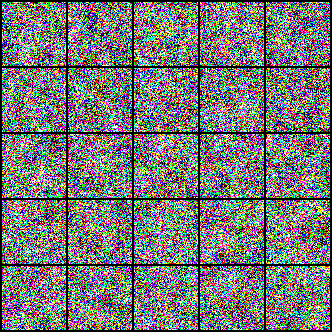

patch size = 17, tau_eta: 0.1


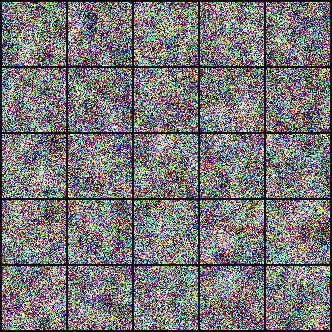

patch size = 17, tau_eta: 0.25


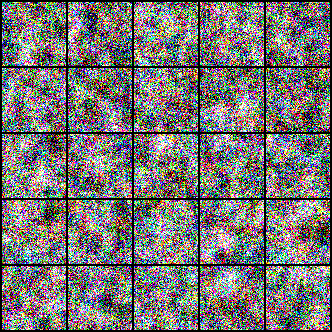

patch size = 17, tau_eta: 0.5


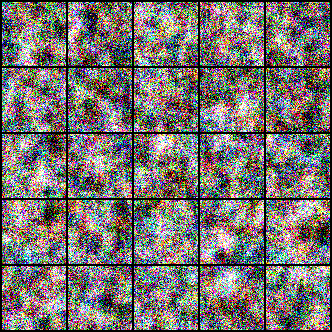

patch size = 17, tau_eta: 1.0


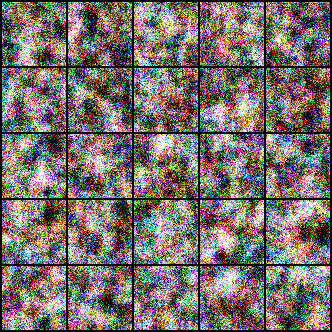

patch size = 17, tau_eta: 2.0


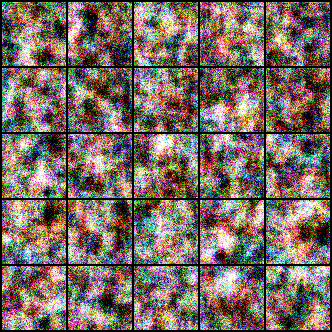

patch size = 17, tau_eta: 5.0


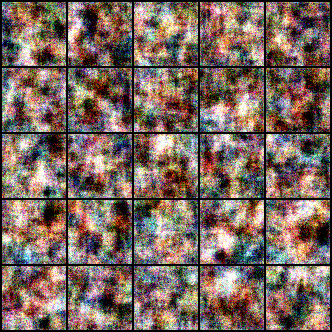

patch size = 17, tau_eta: 10.0


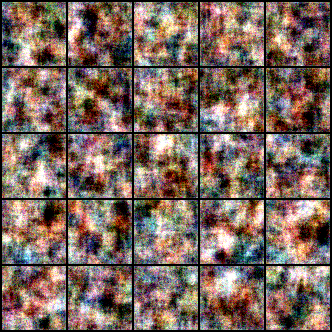

patch size = 17, tau_eta: 100.0


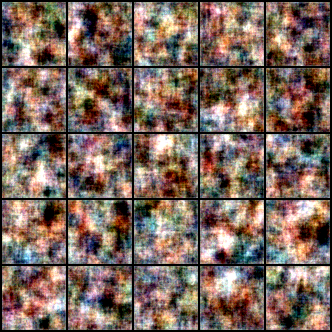

In [18]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
# learning rate * time
tau_eta = 0.25
samples_store = {}
for tau_eta in [0.01, 0.05, 0.1, 0.25, 0.5, 1.0, 2.0, 5.0, 10.0, 100.0]:
    linconv_denoiser_learned_dict = {}
    for noise_level in t_steps:
        denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device, verbose=False)
        # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
        shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
        W_residual = (W_center_init - W_center_optimal)
        residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
        residual_learning = residual_learning.view(C_in, C_in, P, P)
        W_center_learned = W_center_optimal + residual_learning
        # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
        b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
        # build conv model
        conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
        conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
        conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
        linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)
    latents = torch.randn(1024, 3, 64, 64, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, latents, 
                            num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    print(f"patch size = {P}, tau_eta: {tau_eta}")
    display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1)[:25], nrow=5))
    samples_store[tau_eta] = samples

### Patch size = 5

In [160]:
Xtsr64_1000 = fetch_ref_img_tsr(dataset, range(1000))
P = 5
# noise_level = 5.0
device = "cpu"
X = Xtsr64_1000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
# denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
# train_patche_bank = X_patches_flatten.to(torch.float16).cuda()

torch.Size([1000, 75, 4096])


patch size = 5, tau_eta: 0.01


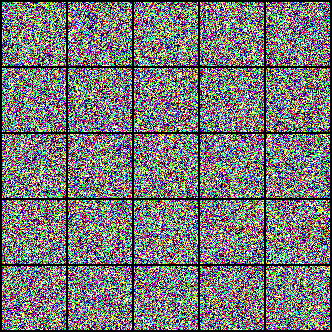

patch size = 5, tau_eta: 0.05


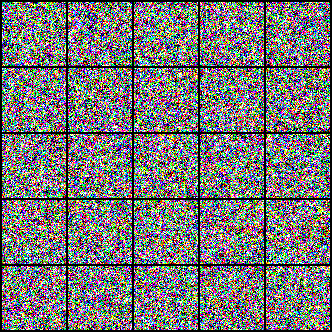

patch size = 5, tau_eta: 0.1


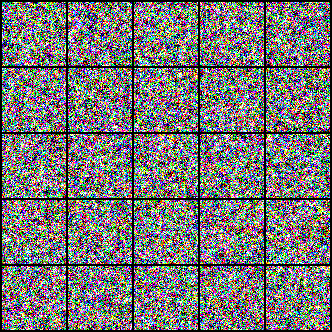

patch size = 5, tau_eta: 0.25


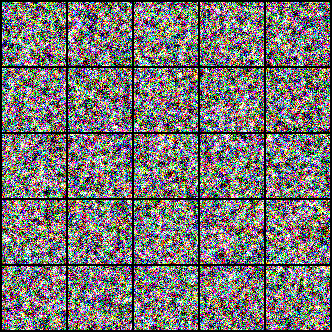

patch size = 5, tau_eta: 0.5


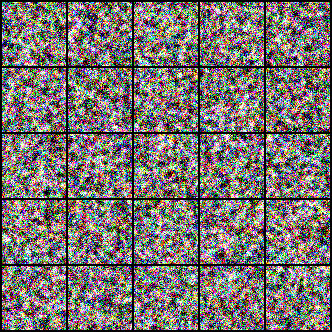

patch size = 5, tau_eta: 1.0


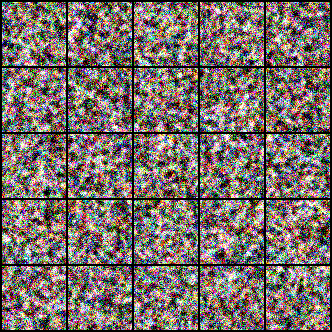

patch size = 5, tau_eta: 2.0


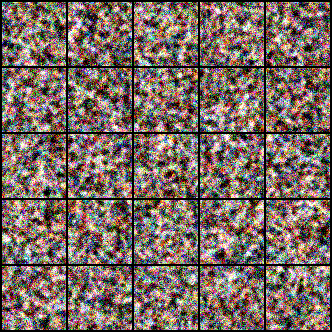

patch size = 5, tau_eta: 5.0


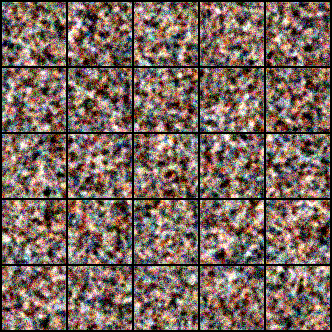

patch size = 5, tau_eta: 10.0


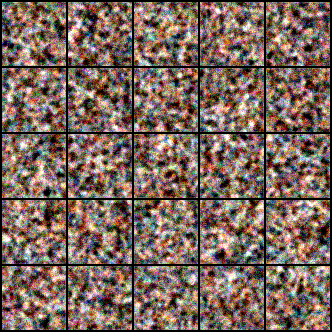

patch size = 5, tau_eta: 100.0


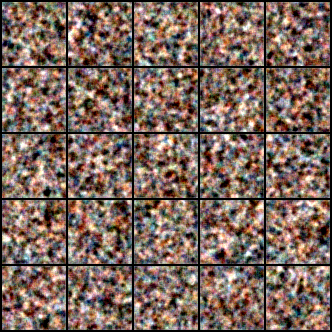

In [161]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
# learning rate * time
tau_eta = 0.25
for tau_eta in [0.01, 0.05, 0.1, 0.25, 0.5, 1.0, 2.0, 5.0, 10.0, 100.0]:
    linconv_denoiser_learned_dict = {}
    for noise_level in t_steps:
        denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device, verbose=False)
        # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
        shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
        W_residual = (W_center_init - W_center_optimal)
        residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
        residual_learning = residual_learning.view(C_in, C_in, P, P)
        W_center_learned = W_center_optimal + residual_learning
        # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
        b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
        # build conv model
        conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
        conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
        conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
        linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)
    latents = torch.randn(25, 3, 64, 64, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, latents, 
                            num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    print(f"patch size = {P}, tau_eta: {tau_eta}")
    display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1), nrow=5))

### UNet Loading

In [162]:
exproot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiffusionSpectralLearningCurve"
expname = "FFHQ64_UNet_CNN_EDM_4blocks_wide128_attn_saveckpt_fewsample_longtrain"
savedir = join(saveroot, expname)
ckptdir = join(savedir, "ckpts")
sample_dir = join(savedir, "samples")
linconv_dir = join(savedir, "linconv_results")
os.makedirs(linconv_dir, exist_ok=True)
config = edict(json.load(open(f"{savedir}/config.json")))
args = edict(json.load(open(f"{savedir}/args.json")))
pprint(config)
unet = create_unet_model(config)
CNN_precd = EDMCNNPrecondWrapper(unet, sigma_data=0.5, sigma_min=0.002, sigma_max=80, rho=7.0)

ckpt_step_list = find_all_ckpt_steps(ckptdir)
CNN_precd.load_state_dict(torch.load(join(ckptdir, f"model_epoch_{ckpt_step_list[-1]:06d}.pth")))

{'attn_resolutions': [8],
 'augment_dim': 0,
 'channel_mult': [1, 2, 2, 2],
 'channels': 3,
 'decoder_init_attn': True,
 'dropout': 0.0,
 'img_size': 64,
 'label_dim': 0,
 'layers_per_block': 1,
 'model_channels': 128}
total number of trainable parameters in the Score Model: 28183299
total number of parameters in the Score Model: 28183299
Found 169 checkpoints in the directory, largest step is 220643


<All keys matched successfully>

ckpt_step: 0


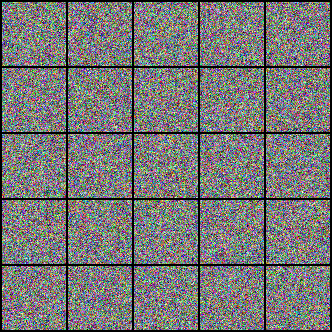

ckpt_step: 1


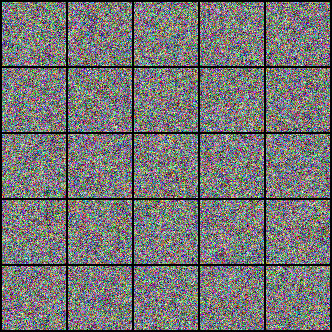

ckpt_step: 2


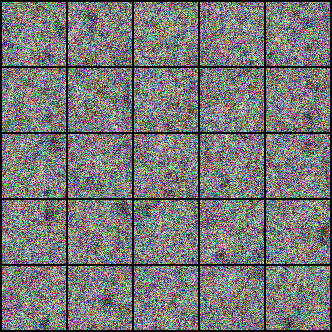

ckpt_step: 3


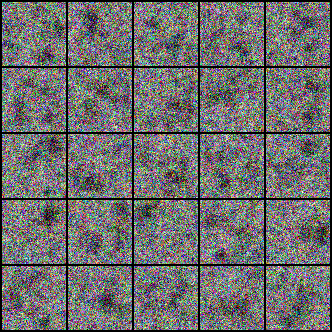

ckpt_step: 4


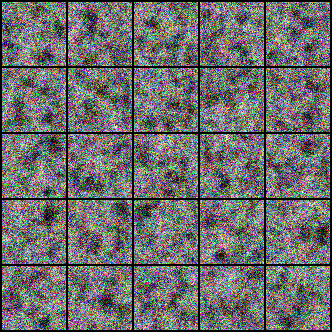

ckpt_step: 5


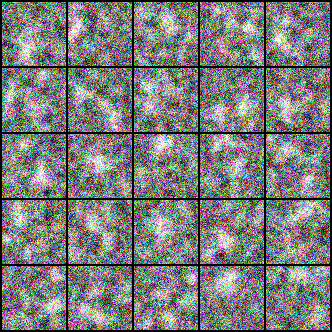

ckpt_step: 6


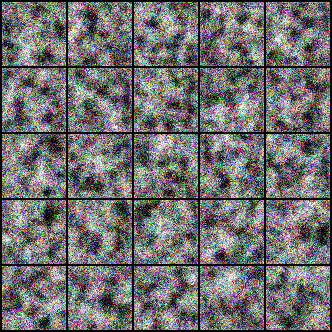

ckpt_step: 7


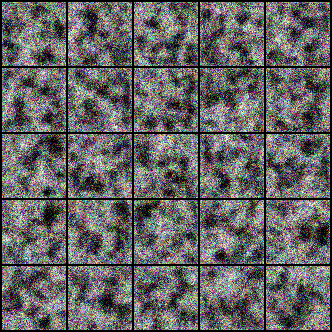

ckpt_step: 8


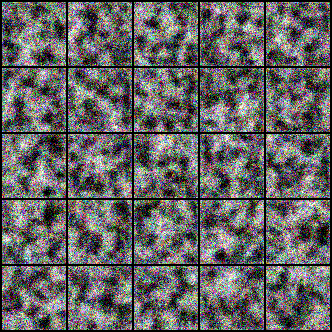

ckpt_step: 9


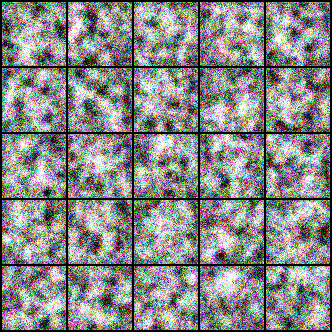

ckpt_step: 10


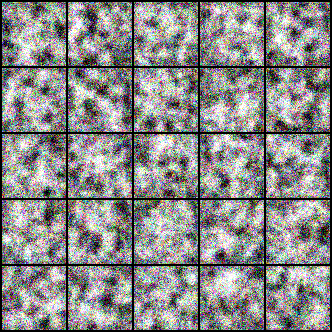

ckpt_step: 11


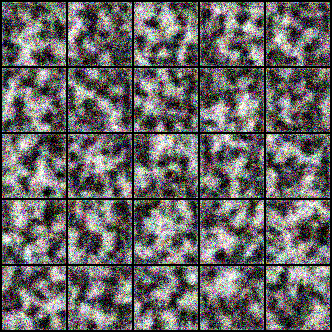

ckpt_step: 12


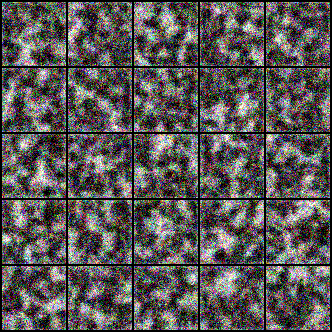

ckpt_step: 13


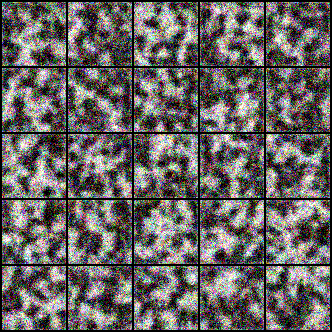

ckpt_step: 14


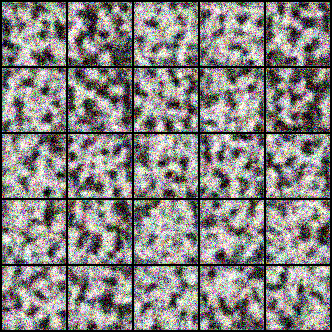

ckpt_step: 15


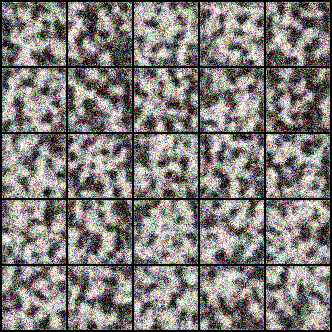

ckpt_step: 16


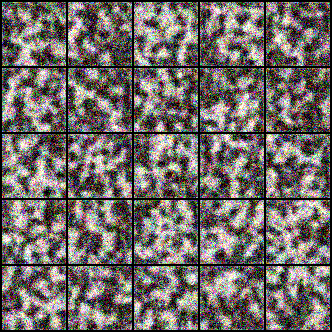

ckpt_step: 17


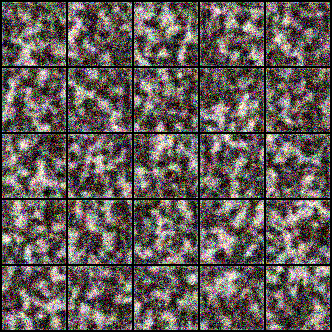

ckpt_step: 18


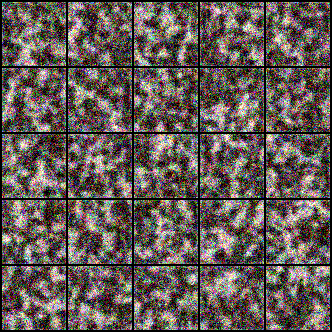

ckpt_step: 20


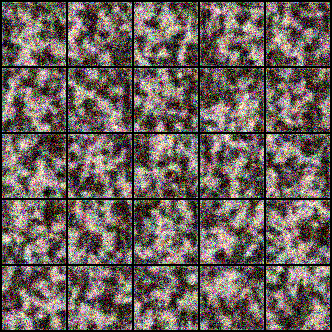

ckpt_step: 21


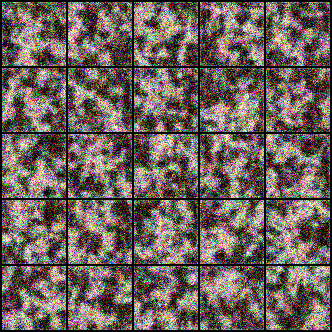

ckpt_step: 22


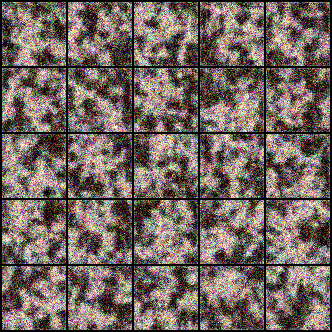

ckpt_step: 24


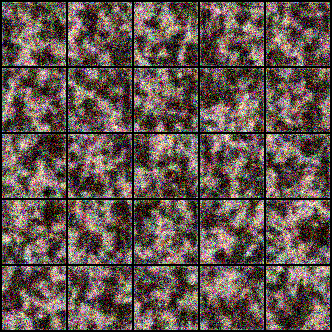

ckpt_step: 25


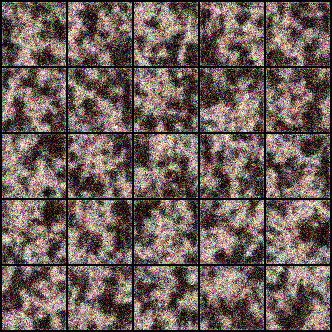

ckpt_step: 27


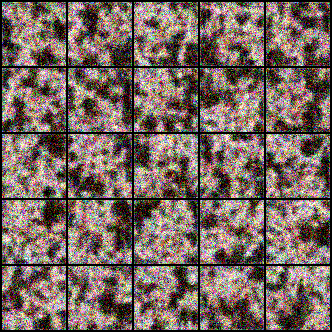

In [170]:
for ckpt_step in ckpt_step_list[:25]:
    CNN_precd.load_state_dict(torch.load(join(ckptdir, f"model_epoch_{ckpt_step:06d}.pth")))
    CNN_precd = CNN_precd.to(device).eval()
    latents = torch.randn(25, 3, 64, 64, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler(CNN_precd, latents, num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    print(f"ckpt_step: {ckpt_step}")
    display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1), nrow=5))

ckpt_step: 29


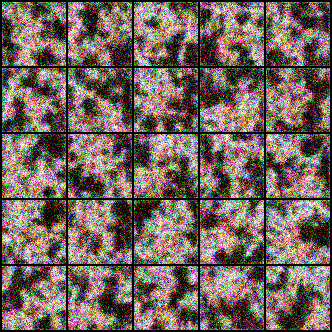

ckpt_step: 31


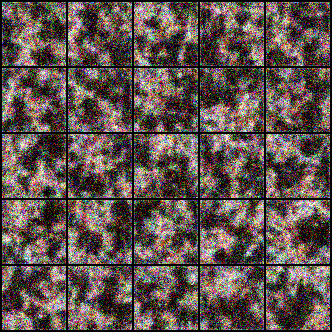

ckpt_step: 33


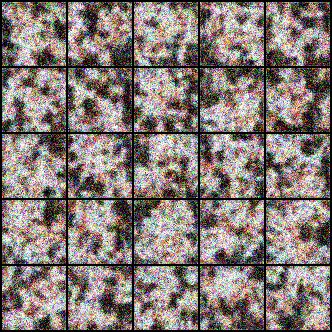

ckpt_step: 35


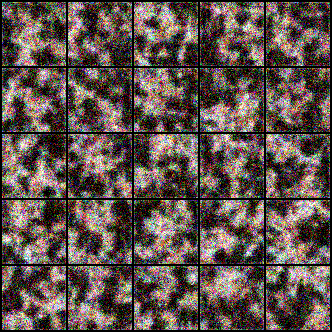

ckpt_step: 37


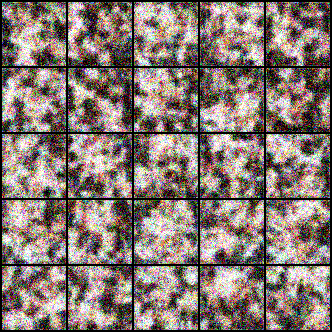

ckpt_step: 39


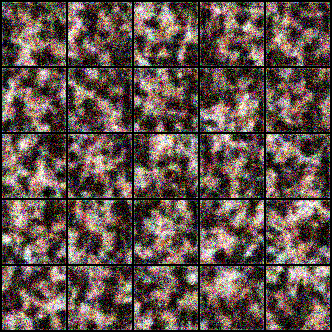

ckpt_step: 42


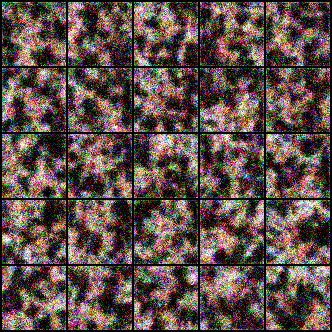

ckpt_step: 45


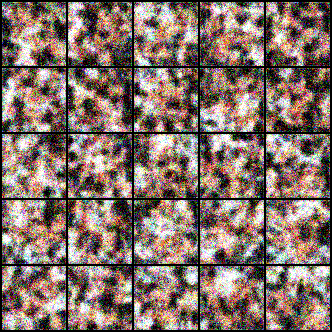

ckpt_step: 48


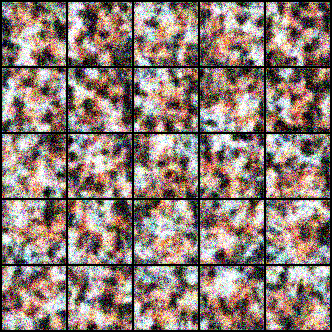

ckpt_step: 51


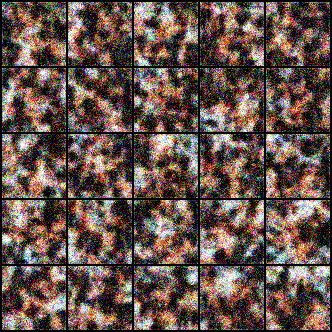

ckpt_step: 54


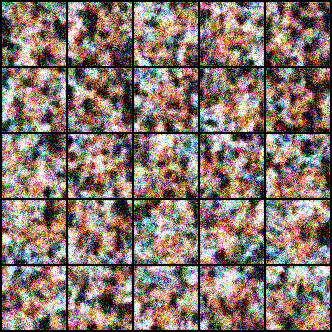

ckpt_step: 57


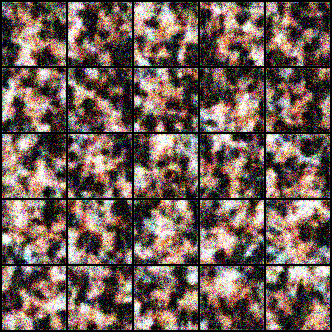

ckpt_step: 61


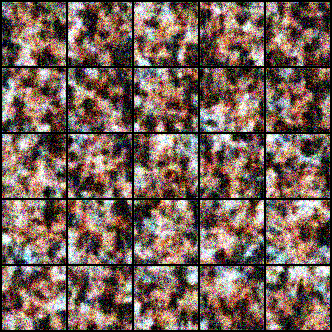

ckpt_step: 65


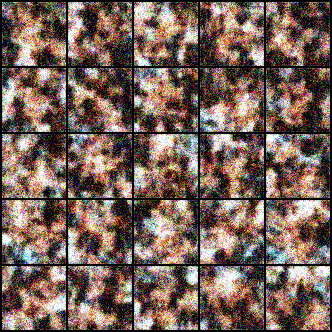

ckpt_step: 69


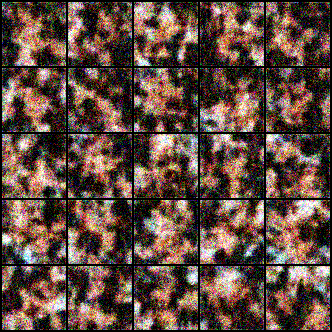

ckpt_step: 74


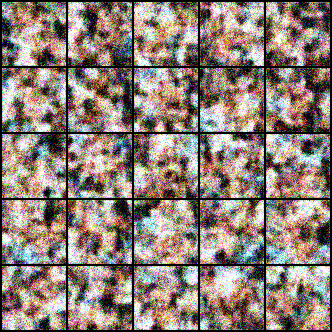

ckpt_step: 79


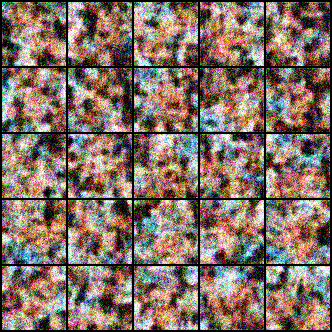

ckpt_step: 84


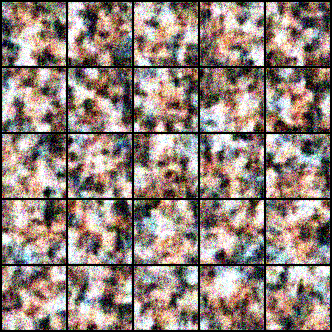

ckpt_step: 89


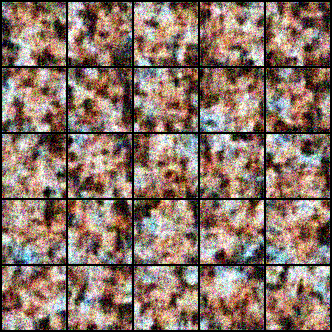

ckpt_step: 95


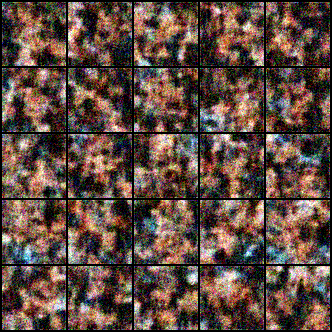

ckpt_step: 101


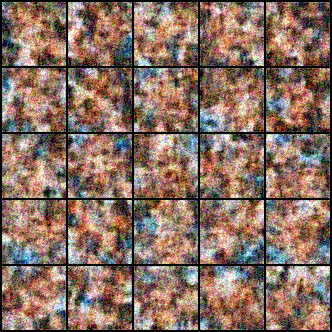

ckpt_step: 108


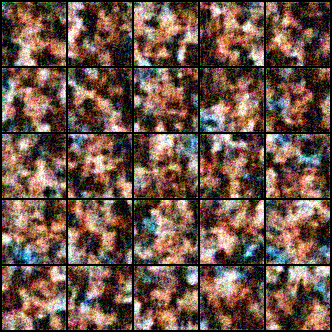

ckpt_step: 115


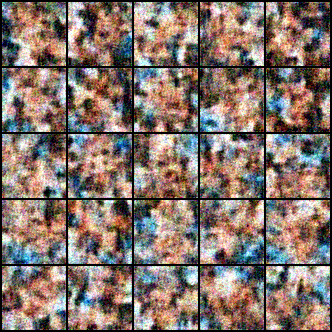

ckpt_step: 122


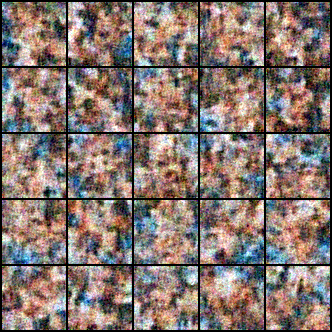

ckpt_step: 130


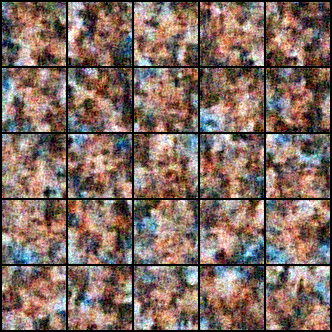

In [171]:
for ckpt_step in ckpt_step_list[25:50]:
    CNN_precd.load_state_dict(torch.load(join(ckptdir, f"model_epoch_{ckpt_step:06d}.pth")))
    CNN_precd = CNN_precd.to(device).eval()
    latents = torch.randn(25, 3, 64, 64, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler(CNN_precd, latents, num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    print(f"ckpt_step: {ckpt_step}")
    display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1), nrow=5))

## Text experiment

In [172]:
!ls {exproot}/word*

/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiffusionSpectralLearningCurve/wordnet_render_dataset:
afhq-32x32.pt				     words32x32_50k
ffhq-32x32-fixed_text.pt		     words32x32_50k_BW
ffhq-32x32.pt				     words32x32_50k_BW.pt
ffhq-32x32-random_word_jitter1-4.pt	     words32x32_50k_BW_words.pkl
ffhq-64x64-fixed_text.pt		     words32x32_50k.pt
ffhq-64x64-random_word_jitter2-8.pt	     words32x32_50k_words.pkl
ffhq-64x64-random_words_jitter2-8_words.pkl

/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiffusionSpectralLearningCurve/words32x32_50k_BW_DiT_P2_192D_3H_6L_EDM_saveckpt_fewsample:
args.json  config.json		      loss_store.pkl  model_final.pth
ckpts	   learned_samples_final.png  loss_traj.pkl   samples

/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiffusionSpectralLearningCurve/words32x32_50k_BW_UNet_CNN_EDM_4blocks_wide128_attn_saveckpt_fewsample:
args.json  config.json		      loss_store.pkl  model_final

In [173]:
exproot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiffusionSpectralLearningCurve"
expname = "words32x32_50k_UNet_CNN_EDM_4blocks_wide128_attn_saveckpt_fewsample"
savedir = join(saveroot, expname)
ckptdir = join(savedir, "ckpts")
sample_dir = join(savedir, "samples")
linconv_dir = join(savedir, "linconv_results")
os.makedirs(linconv_dir, exist_ok=True)
config = edict(json.load(open(f"{savedir}/config.json")))
args = edict(json.load(open(f"{savedir}/args.json")))
pprint(config)
unet = create_unet_model(config)
CNN_precd = EDMCNNPrecondWrapper(unet, sigma_data=0.5, sigma_min=0.002, sigma_max=80, rho=7.0)

ckpt_step_list = find_all_ckpt_steps(ckptdir)
CNN_precd.load_state_dict(torch.load(join(ckptdir, f"model_epoch_{ckpt_step_list[-1]:06d}.pth")))

{'attn_resolutions': [8],
 'augment_dim': 0,
 'channel_mult': [1, 2, 2, 2],
 'channels': 1,
 'decoder_init_attn': True,
 'dropout': 0.0,
 'img_size': 32,
 'label_dim': 0,
 'layers_per_block': 1,
 'model_channels': 128}
total number of trainable parameters in the Score Model: 28178689
total number of parameters in the Score Model: 28178689
Found 88 checkpoints in the directory, largest step is 49999


<All keys matched successfully>

ckpt_step: 0


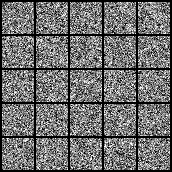

ckpt_step: 2


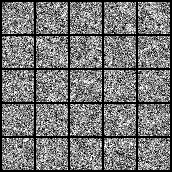

ckpt_step: 4


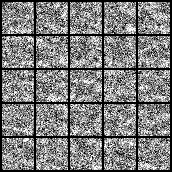

ckpt_step: 6


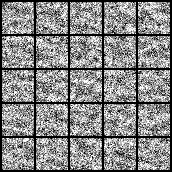

ckpt_step: 8


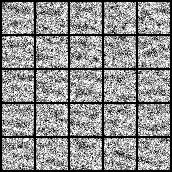

ckpt_step: 11


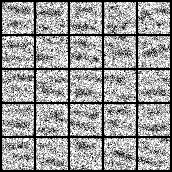

ckpt_step: 13


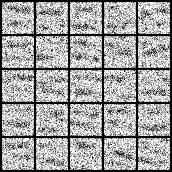

ckpt_step: 17


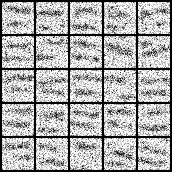

ckpt_step: 21


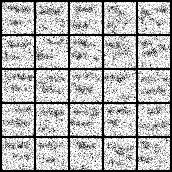

ckpt_step: 26


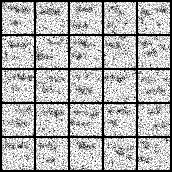

ckpt_step: 33


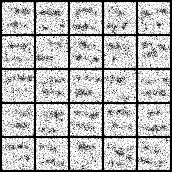

ckpt_step: 41


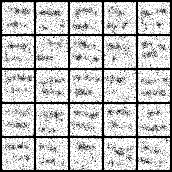

ckpt_step: 51


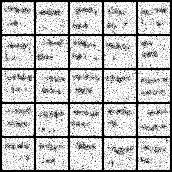

ckpt_step: 63


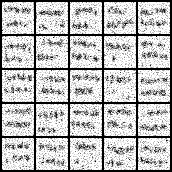

ckpt_step: 79


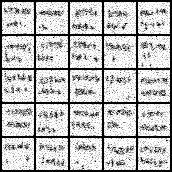

ckpt_step: 98


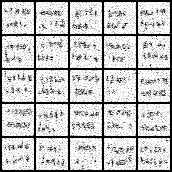

ckpt_step: 122


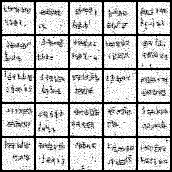

ckpt_step: 152


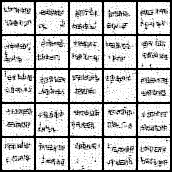

ckpt_step: 189


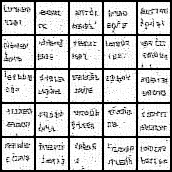

ckpt_step: 236


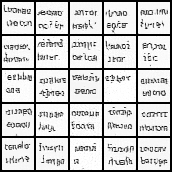

ckpt_step: 293


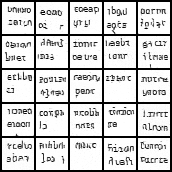

ckpt_step: 365


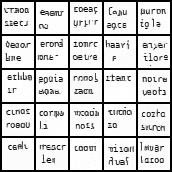

ckpt_step: 454


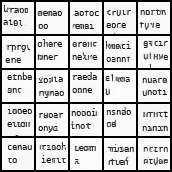

ckpt_step: 566


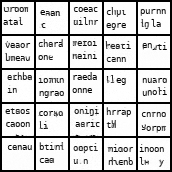

ckpt_step: 704


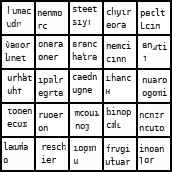

In [178]:
for ckpt_step in ckpt_step_list[:50:2]:
    CNN_precd.load_state_dict(torch.load(join(ckptdir, f"model_epoch_{ckpt_step:06d}.pth")))
    CNN_precd = CNN_precd.to(device).eval()
    latents = torch.randn(25, 1, 32, 32, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler(CNN_precd, latents, num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    print(f"ckpt_step: {ckpt_step}")
    display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1), nrow=5))

In [176]:
dataset_name = "words32x32_50k"
wordimg_root = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/DiffusionSpectralLearningCurve/wordnet_render_dataset"
image_tensor = torch.load(join(wordimg_root, "words32x32_50k.pt"))

In [183]:
Xtsr32_2000.max()

tensor(1.)

In [186]:
Xtsr32_2000 = (image_tensor[:2500, :, :, :] - 0.5) * 0.5#fetch_ref_img_tsr(dataset, range(1000))
P = 15
# noise_level = 5.0
device = "cpu"
X = Xtsr32_2000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)  # Transpose to get n_element by n_element covariance matrix
# denoiser_jacobian, denoiser_bias, W_center, b_center = compute_patch_Gaussian_denoiser(Xtsr64_1000, P, noise_level, device='cpu')
# train_patche_bank = X_patches_flatten.to(torch.float16).cuda()

torch.Size([2500, 225, 1024])


In [188]:
patch_cov

tensor([[0.0194, 0.0133, 0.0106,  ..., 0.0012, 0.0009, 0.0006],
        [0.0133, 0.0196, 0.0133,  ..., 0.0013, 0.0011, 0.0009],
        [0.0106, 0.0133, 0.0198,  ..., 0.0015, 0.0012, 0.0010],
        ...,
        [0.0012, 0.0013, 0.0015,  ..., 0.0195, 0.0136, 0.0112],
        [0.0009, 0.0011, 0.0012,  ..., 0.0136, 0.0193, 0.0137],
        [0.0006, 0.0009, 0.0010,  ..., 0.0112, 0.0137, 0.0191]])

patch size = 15, tau_eta: 0.01


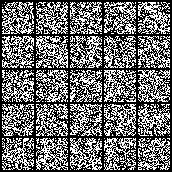

patch size = 15, tau_eta: 0.05


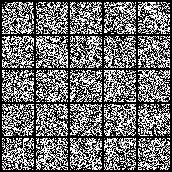

patch size = 15, tau_eta: 0.1


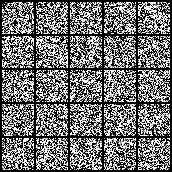

patch size = 15, tau_eta: 0.25


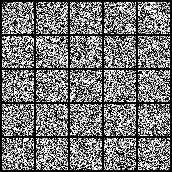

patch size = 15, tau_eta: 0.5


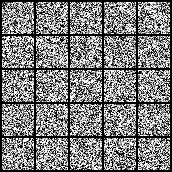

patch size = 15, tau_eta: 1.0


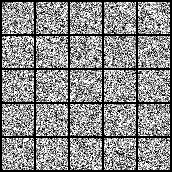

patch size = 15, tau_eta: 2.0


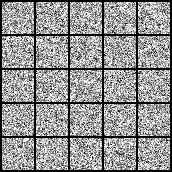

patch size = 15, tau_eta: 5.0


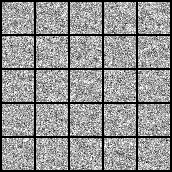

patch size = 15, tau_eta: 10.0


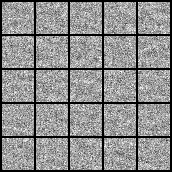

patch size = 15, tau_eta: 100.0


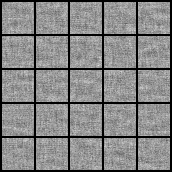

In [187]:
t_steps = get_t_steps(0.002, 80, 70, 7)
device = "cuda"
W_center_init = torch.zeros(C_in, C_in, P, P, device=device) 
b_center_init = torch.zeros(C_in, device=device)
W_center_init[:, :, P//2, P//2] = torch.eye(C_in, device=device)
# learning rate * time
tau_eta = 0.25
for tau_eta in [0.01, 0.05, 0.1, 0.25, 0.5, 1.0, 2.0, 5.0, 10.0, 20.0, 50.0, 100.0]:
    linconv_denoiser_learned_dict = {}
    for noise_level in t_steps:
        denoiser_jacobian, denoiser_bias, W_center_optimal, b_center_optimal = patch_Gaussian_denoiser(patch_mean, patch_cov, noise_level, P, C_in, device=device, verbose=False)
        # simulate learning dynamics by mixing the optimal denoiser with the initial denoiser
        shifted_patch_cov = patch_cov.to(device) + torch.eye(patch_cov.shape[0], device=device) * noise_level ** 2
        W_residual = (W_center_init - W_center_optimal)
        residual_learning = W_residual.view(C_in, -1) @ torch.matrix_exp(- tau_eta * shifted_patch_cov)
        residual_learning = residual_learning.view(C_in, C_in, P, P)
        W_center_learned = W_center_optimal + residual_learning
        # W_center_learned = W_center_optimal + W_residual * torch.exp(-torch.tensor(tau_eta, device=device))
        b_center_learned = b_center_optimal + torch.exp(-torch.tensor(tau_eta, device=device)) * (b_center_init - b_center_optimal)
        # build conv model
        conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
        conv_GaussianPatch.weight.data = W_center_learned.to(device)# W_center_optimal.to(device)#
        conv_GaussianPatch.bias.data = b_center_learned.to(device)#b_center_optimal.to(device)
        linconv_denoiser_learned_dict[noise_level.item()] = conv_GaussianPatch.to(device)
    latents = torch.randn(25, 1, 32, 32, generator=torch.Generator(device=device).manual_seed(0), device=device)
    samples = edm_sampler_with_linconv(linconv_denoiser_learned_dict, latents, 
                            num_steps=70, sigma_min=0.002, sigma_max=80, rho=7)
    print(f"patch size = {P}, tau_eta: {tau_eta}")
    display(to_imgrid(((samples + 1) * 0.5).clamp(0, 1), nrow=5))

In [ ]:

sigma = noise_level
eye_mat = torch.eye(patch_cov.shape[0], device=device)
patch_cov = patch_cov.to(device)
patch_mean = patch_mean.to(device)
eigval, eigvec = torch.linalg.eigh(patch_cov)
denoiser_jacobian = eigvec @ torch.diag(eigval / (eigval + sigma ** 2)) @ eigvec.T
desnoiser_bias = eigvec @ torch.diag(sigma ** 2 / (eigval + sigma ** 2)) @ eigvec.T @ patch_mean
denoiser_jacobian_orig = patch_cov @ torch.linalg.inv(patch_cov + eye_mat * sigma ** 2)
denoiser_bias_orig = (eye_mat - denoiser_jacobian) @ patch_mean
assert torch.allclose(denoiser_jacobian, denoiser_jacobian_orig, atol=1e-5)
assert torch.allclose(desnoiser_bias, denoiser_bias_orig, atol=1e-5)
W_center = denoiser_jacobian.view(C_in, P, P, C_in, P, P)[:, P//2, P//2, :, :, :]
b_center = denoiser_bias.view(C_in, P, P)[:, P//2, P//2]
conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
conv_GaussianPatch.weight.data = W_center
conv_GaussianPatch.bias.data = b_center

In [ ]:
sigma = noise_level
eye_mat = torch.eye(patch_cov.shape[0], device=device)
patch_cov = patch_cov.to(device)
patch_mean = patch_mean.to(device)

# Reshape tensors to identify center indices
patch_shape = (C_in, P, P)
center_idx = P // 2
total_elements = C_in * P * P

# Create index masks for the center pixel
# Create a mask for center pixels across all channels
center_mask = torch.zeros(patch_shape, dtype=torch.bool, device=device)
center_mask[:, P // 2, P // 2] = True
center_mask = center_mask.flatten()
# Compute eigendecomposition
eigval, eigvec = torch.linalg.eigh(patch_cov)
# Compute denoiser components
# denoiser_jacobian = eigvec @ torch.diag(eigval / (eigval + sigma ** 2)) @ eigvec.T
# denoiser_bias = eigvec @ torch.diag(sigma ** 2 / (eigval + sigma ** 2)) @ eigvec.T @ patch_mean
W_center_eig = eigvec[center_mask, :] @ torch.diag(eigval / (eigval + sigma ** 2)) @ eigvec.T
b_center_eig = eigvec[center_mask, :] @ torch.diag(sigma ** 2 / (eigval + sigma ** 2)) @ eigvec.T @ patch_mean
W_center_eig = W_center_eig.view(C_in, C_in, P, P)
b_center_eig = b_center_eig.view(C_in,)
# Verification with original formula
denoiser_jacobian_orig = patch_cov @ torch.linalg.inv(patch_cov + eye_mat * sigma ** 2)
denoiser_bias_orig = (eye_mat - denoiser_jacobian) @ patch_mean
assert torch.allclose(denoiser_jacobian, denoiser_jacobian_orig, atol=1e-5)
assert torch.allclose(denoiser_bias, denoiser_bias_orig, atol=1e-5)
W_center = denoiser_jacobian.view(C_in, P, P, C_in, P, P)[:, P//2, P//2, :, :, :]
b_center = denoiser_bias.view(C_in, P, P)[:, P//2, P//2]

assert torch.allclose(W_center, W_center_eig, atol=1e-5)
assert torch.allclose(b_center, b_center_eig, atol=1e-5)
# Create convolutional layer
conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
conv_GaussianPatch.weight.data = W_center
conv_GaussianPatch.bias.data = b_center

In [ ]:
sigma = noise_level
eye_mat = torch.eye(patch_cov.shape[0], device=device)
patch_cov = patch_cov.to(device)
patch_mean = patch_mean.to(device)

# Reshape tensors to identify center indices
patch_shape = (C_in, P, P)
center_idx = P // 2
total_elements = C_in * P * P

# Create index masks for the center pixel
# Create a mask for center pixels across all channels
center_mask = torch.zeros(patch_shape, dtype=torch.bool, device=device)
center_mask[:, P // 2, P // 2] = True
center_mask = center_mask.flatten()
# Compute eigendecomposition
eigval, eigvec = torch.linalg.eigh(patch_cov)
# Compute denoiser components
# denoiser_jacobian = eigvec @ torch.diag(eigval / (eigval + sigma ** 2)) @ eigvec.T
# denoiser_bias = eigvec @ torch.diag(sigma ** 2 / (eigval + sigma ** 2)) @ eigvec.T @ patch_mean
W_center_eig = eigvec[center_mask, :] @ torch.diag(eigval / (eigval + sigma ** 2)) @ eigvec.T
b_center_eig = eigvec[center_mask, :] @ torch.diag(sigma ** 2 / (eigval + sigma ** 2)) @ eigvec.T @ patch_mean
W_center_eig = W_center_eig.view(C_in, C_in, P, P)
b_center_eig = b_center_eig.view(C_in,)
# Create convolutional layer
conv_GaussianPatch = torch.nn.Conv2d(C_in, C_out, kernel_size=P, padding=P//2, stride=1)
conv_GaussianPatch.weight.data = W_center_eig
conv_GaussianPatch.bias.data = b_center_eig

### Single Noise scale adaptive denoising version

In [ ]:
import math
import torch
import torch.nn as nn
import torch.nn.functional as F

class GaussianPatchFilter(nn.Module):
    def __init__(self, patch_cov: torch.Tensor, patch_mean: torch.Tensor, C_in: int, P: int):
        """
        Args:
            patch_cov: Tensor of shape (C_in*P*P, C_in*P*P), the full patch covariance.
            patch_mean: Tensor of shape (C_in*P*P,), the flattened patch-mean.
            C_in:      Number of input channels.
            P:         Patch spatial size (patch is C_in x P x P).
        """
        super().__init__()
        M = C_in * P * P
        assert patch_cov.shape == (M, M)
        assert patch_mean.numel() == M

        self.C_in = C_in
        self.P = P

        # store mean
        self.register_buffer('patch_mean_flat', patch_mean.view(M))

        # precompute eigendecomposition of the patch covariance
        eigval, eigvec = torch.linalg.eigh(patch_cov)
        self.register_buffer('eigval', eigval)      # (M,)
        self.register_buffer('eigvec', eigvec)      # (M,M)

        # build a mask that picks out the center pixel (for each channel) in the flattened patch
        center_idx = P // 2
        mask = torch.zeros(M, dtype=torch.bool, device=patch_cov.device)
        mask[:, center_idx, center_idx] = True
        self.register_buffer('center_mask', mask)    # (M,)

    def to(self, device):
        self.patch_mean_flat = self.patch_mean_flat.to(device)
        self.eigval = self.eigval.to(device)
        self.eigvec = self.eigvec.to(device)
        self.center_mask = self.center_mask.to(device)
        return self
    
    def forward(self, x: torch.Tensor, noise_level: float) -> torch.Tensor:
        """
        Args:
            x:           Input tensor of shape (B, C_in, H, W).
            noise_level: Scalar noise σ at which to build the filter.
        Returns:
            Tensor of shape (B, C_in, H, W), after applying the adaptive Gaussian patch filter.
        """
        σ2 = noise_level ** 2
        # build the two spectral coefficients
        denom = self.eigval + σ2                     # (M,)
        α = self.eigval / denom                      # (M,)  → denoiser Jacobian spectrum
        β =   σ2   / denom                           # (M,)  → denoiser bias spectrum
        # select only the center rows of eigvec  →  shape (C_in, M)
        Vc = self.eigvec[self.center_mask, :]         # (C_in, M)
        # build the convolutional weight matrix for the center pixel:
        #   Wc = Vc @ diag(α) @ Vᵀ   →  shape (C_in, M)
        Wc_flat = Vc @ (α.unsqueeze(0) * self.eigvec.T)   # (C_in, M)
        # build the center bias:
        #   bc = Vc @ diag(β) @ Vᵀ @ mean_flat   →  (C_in,)
        bc = Vc @ ((β.unsqueeze(0) * self.eigvec.T) @ self.patch_mean_flat)  # (C_in,)
        # reshape weight into conv2d kernel shape: (out_channels, in_channels, P, P)
        W = Wc_flat.view(self.C_in, self.C_in, self.P, self.P)
        # apply convolution
        return F.conv2d(x, weight=W, bias=bc, padding=self.P // 2, stride=1)

In [ ]:
eigvec.shape

torch.Size([675, 675])

### Batch multi noise scale denoiser

In [ ]:
eigen_dim = len(eigval)
# first use eigvec denoiser to get the eigen_dim
conv_eigvec = torch.nn.Conv2d(C_in, eigen_dim, kernel_size=P, padding=P//2, stride=1)
conv_eigvec.weight.data = eigvec.T.view(-1, C_in, P, P)
conv_eigvec.bias.data = - eigvec.T @ patch_mean

In [ ]:
sigma_vec = torch.exp(torch.randn(5))
eigrepr = conv_eigvec(Xtsr64_1000[0:5],)
print(eigrepr.shape)
print(sigma_vec)
print(eigval.shape)
adaptive_eigval_multiplier = eigval[None, :] / (sigma_vec[:, None] ** 2 + eigval[None, :])
print(adaptive_eigval_multiplier.shape)
shrinkaged_eigrepr = adaptive_eigval_multiplier[:, :, None, None] * eigrepr
shrinkaged_eigrepr.shape

torch.Size([5, 675, 64, 64])
tensor([7.3823, 1.8835, 0.8110, 0.6146, 0.7629])
torch.Size([675])


torch.Size([5, 675, 64, 64])

In [ ]:
eigvec_center = eigvec[center_mask, :]
mean_center = patch_mean[center_mask]
print(eigvec_center.shape)
print(mean_center.shape)
readout_conv = torch.nn.Conv2d(eigen_dim, C_out, kernel_size=1, padding=0, stride=1)
readout_conv.weight.data = eigvec_center.view(C_out, eigen_dim, 1, 1)
readout_conv.bias.data = mean_center
denoised_X = readout_conv(shrinkaged_eigrepr)
print(denoised_X.shape)

torch.Size([3, 675])
torch.Size([3])
torch.Size([5, 3, 64, 64])


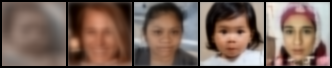

In [ ]:
to_imgrid((denoised_X.cpu()*0.5 + 0.5).clamp(0, 1), nrow=5)

In [ ]:
eigen_dim = len(eigval)
center_mask = torch.zeros(C_in, P, P, dtype=torch.bool, device=device)
center_mask[:, P//2, P//2] = True
center_mask = center_mask.flatten()
# first use eigvec denoiser to get the eigen_dim
conv_eigvec = torch.nn.Conv2d(C_in, eigen_dim, kernel_size=P, padding=P//2, stride=1)
conv_eigvec.weight.data = eigvec.T.view(-1, C_in, P, P)
conv_eigvec.bias.data = - eigvec.T @ patch_mean
eigvec_center = eigvec[center_mask, :]
mean_center = patch_mean[center_mask]
print(eigvec_center.shape)
print(mean_center.shape)
readout_conv = torch.nn.Conv2d(eigen_dim, C_out, kernel_size=1, padding=0, stride=1)
readout_conv.weight.data = eigvec_center.view(C_out, eigen_dim, 1, 1)
readout_conv.bias.data = mean_center


eigrepr = conv_eigvec(Xtsr64_1000[0:5],)
adaptive_eigval_multiplier = eigval[None, :] / (sigma_vec[:, None] ** 2 + eigval[None, :])
print(adaptive_eigval_multiplier.shape)
shrinkaged_eigrepr = adaptive_eigval_multiplier[:, :, None, None] * eigrepr
print(shrinkaged_eigrepr.shape)
denoised_X = readout_conv(shrinkaged_eigrepr)
print(denoised_X.shape)

### Function version of Adaptive Gaussian denoiser

In [ ]:
import torch
import torch.nn as nn

class AdaptiveGaussianDenoiser(nn.Module):
    def __init__(self,
                 eigvec: torch.Tensor,     # shape (C_in*P*P, eigen_dim)
                 eigval: torch.Tensor,     # shape (eigen_dim,)
                 patch_mean: torch.Tensor,  # shape (C_in*P*P,)
                 patch_size: int):
        """
        eigvec:       eigenvectors of patch covariance, flattened rows, columns as eigen vector
        eigval:       eigenvalues of patch covariance
        patch_mean:   mean vector of each patch entry
        patch_size:   spatial size P of each patch (P x P)
        """
        super().__init__()
        device = eigvec.device
        self.register_buffer('eigval', eigval)
        self.eigen_dim = eigval.numel()
        self.P = patch_size
        
        # infer C_in and C_out from shapes
        total_entries = patch_mean.numel()
        C_in = total_entries // (self.P**2)
        C_out = C_in
        self.C_in = C_in
        self.C_out = C_out
        # 1) conv to project input patches onto eigen-basis
        self.conv_eigvec = nn.Conv2d(
            in_channels=C_in,
            out_channels=self.eigen_dim,
            kernel_size=self.P,
            padding=self.P//2,
            bias=True
        )
        # set weights = eigvec.T reshaped, bias = -eigvec.T @ patch_mean
        self.conv_eigvec.weight.data = eigvec.T.view(
            self.eigen_dim, C_in, self.P, self.P
        )
        self.conv_eigvec.bias.data = - (eigvec.T @ patch_mean)
        # freeze these parameters
        for param in (self.conv_eigvec.weight, self.conv_eigvec.bias):
            param.requires_grad_(False)

        # 2) conv to read out only the center pixel projection
        # build a mask that picks the center location in each flattened row
        center_mask = torch.zeros(C_in, self.P, self.P, dtype=torch.bool, device=device)
        center_mask[:, self.P//2, self.P//2] = True
        center_mask   = center_mask.view(-1)          # shape (C_in*P*P,)
        eigvec_center = eigvec[center_mask, :]        # (C_out, eigen_dim)
        mean_center   = patch_mean[center_mask]       # (C_out,)
        self.readout_conv = nn.Conv2d(
            in_channels=self.eigen_dim,
            out_channels=C_out,
            kernel_size=1,
            bias=True
        )
        self.readout_conv.weight.data = eigvec_center.view(
            C_out, self.eigen_dim, 1, 1
        )
        self.readout_conv.bias.data = mean_center
        for param in (self.readout_conv.weight, self.readout_conv.bias):
            param.requires_grad_(False)

    def forward(self, x: torch.Tensor, sigma_vec: torch.Tensor) -> torch.Tensor:
        """
        x:           (batch, C_in, H, W)
        sigma_vec:   (batch,) noise level for each sample
        returns:     (batch, C_out, H, W) denoised output
        """
        sigma_vec = sigma_vec.view(-1)
        # project onto eigen-space
        eigrepr = self.conv_eigvec(x)  # shape (B, eigen_dim, H, W)
        # compute per-sample shrinkage factors
        # shape (B, eigen_dim)
        shrink_factors = self.eigval[None, :] / (sigma_vec[:, None]**2 + self.eigval[None, :])
        # reshape to broadcast over spatial dims: (B, eigen_dim, 1, 1)
        shrink_factors = shrink_factors[..., None, None]
        # apply shrinkage in eigen-space
        shr_eigrepr = eigrepr * shrink_factors
        # reconstruct only center pixel outputs
        out = self.readout_conv(shr_eigrepr)  # (B, C_out, H, W)
        return out

In [ ]:
def compute_mean_cov_eigen(X, P, out_device="cuda"):
    unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
    X_patches = unfold(X)
    print(X_patches.shape)
    X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
    print(X_patches_flatten.shape)
    patch_mean = X_patches_flatten.mean(dim=0)
    patch_cov = torch.cov(X_patches_flatten.T).to(device)
    eigval, eigvec = torch.linalg.eigh(patch_cov.cuda())
    return patch_mean.to(out_device), patch_cov.to(out_device), eigval.to(out_device), eigvec.to(out_device)

In [ ]:
Xtsr64_1000 = fetch_ref_img_tsr(dataset, range(1000))
P = 15
device = "cpu"

X = Xtsr64_1000
C_out = X.shape[1]
C_in = X.shape[1]
# X: (N, C_in, H, W), Y: (N, C_out, H_out, W_out)
unfold = torch.nn.Unfold(kernel_size=P, padding=P//2, stride=1)
X_patches = unfold(X)
print(X_patches.shape)
# n_samples, n_patch_elements, n_positions = X_patches.shape
X_patches_flatten = rearrange(X_patches, "n_sample n_element n_position -> (n_sample n_position) n_element").to(device)
patch_mean = X_patches_flatten.mean(dim=0)
patch_cov = torch.cov(X_patches_flatten.T).to(device)
eigval, eigvec = torch.linalg.eigh(patch_cov.cuda())

torch.Size([1000, 675, 4096])


In [ ]:
P = 15
patch_mean, patch_cov, eigval, eigvec = compute_mean_cov_eigen(Xtsr64_1000[0:1000], P)

torch.Size([1000, 675, 4096])
torch.Size([4096000, 675])


In [ ]:
adaptive_denoiser = AdaptiveGaussianDenoiser(eigvec, eigval, patch_mean, P)

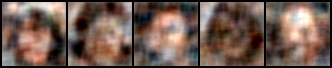

In [ ]:
# sigma_vec = torch.exp(torch.randn(5))
sigma_vec = 3 * torch.ones(5)
X_orig = fetch_ref_img_tsr(dataset, range(2000, 2005))
X_noisy = X_orig + torch.randn_like(X_orig) * sigma_vec[:, None, None, None]

denoised_X = adaptive_denoiser(X_noisy.cuda(), sigma_vec.cuda())
denoised_X_pp = (denoised_X.cpu() * 0.5 + 0.5).clamp(0, 1)
display(to_imgrid(denoised_X_pp.cpu(), nrow=5))

In [ ]:
noise_level = 3
conv_GaussianPatch = build_linear_conv_denoiser_layer(patch_mean, patch_cov, noise_level, P, C_in, device='cuda')

Computing patch Gaussian denoiser
torch.Size([3, 3, 15, 15])
torch.Size([3])


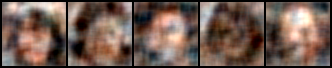

In [ ]:
denoised_X_linconv = conv_GaussianPatch(X_noisy.cuda())
denoised_X_linconv_pp = (denoised_X_linconv.cpu() * 0.5 + 0.5).clamp(0, 1)
display(to_imgrid(denoised_X_linconv_pp.cpu(), nrow=5))

In [ ]:
assert torch.allclose(denoised_X, denoised_X_linconv, atol=1e-3, rtol=1e-3)
assert torch.allclose(denoised_X_pp, denoised_X_linconv_pp, atol=1e-4, rtol=1e-4)